# Analiza różnych czynników na płacę zawodu developerskiego

### Celem tego dokumentu było zapoznanie się z danymi z przeprowadzonej ankiety przez StackOverflow w celu zbadania różnych powiązań, oraz znalezienia czynników które mają wpływ na płacę w zawodzie

In [103]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

Wczytanie danych: <br>
Data - Wyniki ankiety przeprowadzonej na StackOverflow w 2017 <br>
Schema - opis każdej kolumny

In [104]:
data = pd.read_csv('survey_results_public.csv')
schema=pd.read_csv('survey_results_schema.csv')

In [105]:
print("shape of data:" + "\n" + str(data.shape)+ "\n" + "shape of schema:"+ "\n" + str(schema.shape))

shape of data:
(51392, 154)
shape of schema:
(154, 2)


Można wywnioskować, że wszystkie kolumny z ramki data są opisane w schema

Pokazanie ramki schema w celu zapoznania się z opisami konkretnych kolumn

In [106]:
schema

,Column,Question
0,Respondent,Respondent ID number
1,Professional,Which of the following best describes you?
2,ProgramHobby,Do you program as a hobby or contribute to ope...
3,Country,In which country do you currently live?
4,University,"Are you currently enrolled in a formal, degree..."
...,...,...
149,QuestionsInteresting,The questions were interesting
150,QuestionsConfusing,The questions were confusing
151,InterestedAnswers,I'm interested in learning how other developer...
152,Salary,"What is your current annual base salary, befor..."


In [107]:
data.head()

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,CompanyType,YearsProgram,YearsCodedJob,YearsCodedJobPast,DeveloperType,WebDeveloperType,MobileDeveloperType,NonDeveloperType,CareerSatisfaction,JobSatisfaction,ExCoderReturn,ExCoderNotForMe,ExCoderBalance,ExCoder10Years,ExCoderBelonged,ExCoderSkills,ExCoderWillNotCode,ExCoderActive,PronounceGIF,ProblemSolving,BuildingThings,LearningNewTech,BoringDetails,JobSecurity,DiversityImportant,AnnoyingUI,FriendsDevelopers,RightWrongWay,UnderstandComputers,SeriousWork,InvestTimeTools,WorkPayCare,KinshipDevelopers,ChallengeMyself,CompetePeers,ChangeWorld,JobSeekingStatus,HoursPerWeek,LastNewJob,AssessJobIndustry,AssessJobRole,AssessJobExp,AssessJobDept,AssessJobTech,AssessJobProjects,AssessJobCompensation,AssessJobOffice,AssessJobCommute,AssessJobRemote,AssessJobLeaders,AssessJobProfDevel,AssessJobDiversity,AssessJobProduct,AssessJobFinances,ImportantBenefits,ClickyKeys,JobProfile,ResumePrompted,LearnedHiring,ImportantHiringAlgorithms,ImportantHiringTechExp,ImportantHiringCommunication,ImportantHiringOpenSource,ImportantHiringPMExp,ImportantHiringCompanies,ImportantHiringTitles,ImportantHiringEducation,ImportantHiringRep,ImportantHiringGettingThingsDone,Currency,Overpaid,TabsSpaces,EducationImportant,EducationTypes,SelfTaughtTypes,TimeAfterBootcamp,CousinEducation,WorkStart,HaveWorkedLanguage,WantWorkLanguage,HaveWorkedFramework,WantWorkFramework,HaveWorkedDatabase,WantWorkDatabase,HaveWorkedPlatform,WantWorkPlatform,IDE,AuditoryEnvironment,Methodology,VersionControl,CheckInCode,ShipIt,OtherPeoplesCode,ProjectManagement,EnjoyDebugging,InTheZone,DifficultCommunication,CollaborateRemote,MetricAssess,EquipmentSatisfiedMonitors,EquipmentSatisfiedCPU,EquipmentSatisfiedRAM,EquipmentSatisfiedStorage,EquipmentSatisfiedRW,InfluenceInternet,InfluenceWorkstation,InfluenceHardware,InfluenceServers,InfluenceTechStack,InfluenceDeptTech,InfluenceVizTools,InfluenceDatabase,InfluenceCloud,InfluenceConsultants,InfluenceRecruitment,InfluenceCommunication,StackOverflowDescribes,StackOverflowSatisfaction,StackOverflowDevices,StackOverflowFoundAnswer,StackOverflowCopiedCode,StackOverflowJobListing,StackOverflowCompanyPage,StackOverflowJobSearch,StackOverflowNewQuestion,StackOverflowAnswer,StackOverflowMetaChat,StackOverflowAdsRelevant,StackOverflowAdsDistracting,StackOverflowModeration,StackOverflowCommunity,StackOverflowHelpful,StackOverflowBetter,StackOverflowWhatDo,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary
0,1,Student,"Yes, both",United States,No,"Not employed, and not looking for work",Secondary school,NaN,NaN,NaN,NaN,2 to 3 years,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"With a soft ""g,"" like ""jiff""",Strongly agree,Strongly agree,Agree,Disagree,Strongly agree,Agree,Agree,Disagree,Somewhat agree,Disagree,Strongly agree,Strongly agree,Strongly disagree,Agree,Agree,Disagree,Agree,"I'm not actively looking, but I am open to new...",0.0,Not applicable/ never,Very important,Very important,Important,Very important,Very important,Very important,Important,Very important,Very important,Very important,Very important,Very important,Somewhat important,Not very important,Somewhat important,Stock options; Vacation/days off; Remote options,Yes,Other,NaN,NaN,Important,Important,Important,Somewhat important,Important,Not very important,Not very important,Not at all important,Somewhat important,Very important,NaN,NaN,Tabs,NaN,Online course; Open source contributions,NaN,NaN,NaN,6:00 AM,Swift,Swift,NaN,NaN,NaN,NaN,iOS,iOS,Atom; Xcode,Turn on some music,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Somewhat satisfied,Not very satisfied,Not at all satisfied,Very satisfied,Satisfied,Not very satisfied,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I have created a CV or Developer Story on Stac...,9.0,Desktop; iOS app,At leas

Sprawdzenie jakiego typu dane są przechowywane w każdej kolumnie

In [108]:
data.dtypes

Respondent                int64
Professional             object
ProgramHobby             object
Country                  object
University               object
                         ...   
QuestionsInteresting     object
QuestionsConfusing       object
InterestedAnswers        object
Salary                  float64
ExpectedSalary          float64
Length: 154, dtype: object

Zauważamy, że floatami/intami są kolumny: 'JobSatisfaction',
'HoursPerWeek',
'StackOverflowSatisfaction',
'Salary',
'ExpectedSalary'. Resztę kolumn można zamienić na floaty (np strongly disagree = 0, disagree = 1 itd)

In [109]:
entries = len(data.index)
nansum = {}
for col in data.columns:
    nansum[col] = data[col].isna().sum()

Stworzenie ramki danych nan_frame, która będzie nam pokazywać jaki % danej kolumny jest wypełniony wartościami NaN

In [110]:
nan_frame = pd.DataFrame.from_dict(data=nansum, orient='index')
nan_frame.rename(columns={0:'NaN Count'}, inplace=True)

In [111]:
nan_frame['percentage'] = nan_frame['NaN Count'].apply(lambda x: x/entries * 100)

In [112]:
nan_frame['type'] = nan_frame['NaN Count'].apply(lambda x: x/entries * 100)

In [113]:
nan_frame

,NaN Count,percentage,type
Respondent,0,0.000000,0.000000
Professional,0,0.000000,0.000000
ProgramHobby,0,0.000000,0.000000
Country,0,0.000000,0.000000
University,0,0.000000,0.000000
...,...,...,...
QuestionsInteresting,16856,32.798879,32.798879
QuestionsConfusing,16973,33.026541,33.026541
InterestedAnswers,16780,32.650996,32.650996
Salary,38501,74.916329,74.916329


<AxesSubplot:>

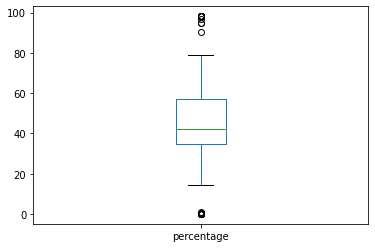

In [114]:
nan_frame['percentage'].plot.box()

Stworzenie hisogramu, który powie nam jak wiele jest kolumn w których NaN stanowi określony %

<AxesSubplot:ylabel='Frequency'>

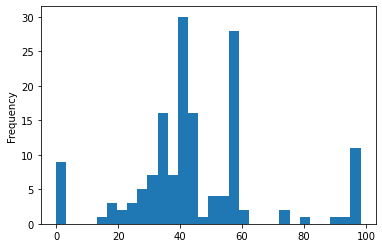

In [115]:
nan_frame['percentage'].plot.hist(bins=30)

Zauważamy, że kolumn gdzie wartość NaN stanowi ponad 60% jest niewiele więc wyświetlamy wszystkie te kolumny w celu sprawdzenia czy są one istotne

In [116]:
nan_frame[nan_frame['percentage'] > 60]

,NaN Count,percentage,type
YearsCodedJobPast,50418,98.104763,98.104763
WebDeveloperType,40696,79.187422,79.187422
MobileDeveloperType,49839,96.978129,96.978129
NonDeveloperType,46502,90.484900,90.484900
ExCoderReturn,50469,98.204001,98.204001
ExCoderNotForMe,50471,98.207892,98.207892
ExCoderBalance,50469,98.204001,98.204001
ExCoder10Years,50475,98.215676,98.215676
ExCoderBelonged,50464,98.194271,98.194271
ExCoderSkills,50457,98.180651,98.180651


Zauważamy, że wartość Salary, którą będziemy chcieli przewidywać jest pusta w 75% wierszy co oznacza, Będziemy chcieli korzystać z pozostałych 25% wierszy. Nie będziemy korzystać z kolumn, w którch NaN stanowi więcej niż 90%.

In [117]:
#komórka do zmiany ustawień wyświetlania dataframe
#pd.set_option('display.max_columns', None)
pd.set_option("max_rows", None)
nan_frame

,NaN Count,percentage,type
Respondent,0,0.000000,0.000000
Professional,0,0.000000,0.000000
ProgramHobby,0,0.000000,0.000000
Country,0,0.000000,0.000000
University,0,0.000000,0.000000
EmploymentStatus,0,0.000000,0.000000
FormalEducation,0,0.000000,0.000000
MajorUndergrad,8551,16.638776,16.638776
HomeRemote,7384,14.367995,14.367995
CompanySize,12470,24.264477,24.264477


Sprawdzenie jak wyglądają dane znajdujące się w kolumnie JobSatisfaction

In [118]:
np.sort(data['JobSatisfaction'].unique())

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., nan])

Oprócz liczb jest tam NaN. Ta kolumna może się przydać w wyznaczaniu wynagrodzenia.

In [119]:
%matplotlib notebook
# pd.reset_option(“max_columns”)
pd.set_option('display.max_columns', None)
pd.set_option("max_rows", None)
data[data['YearsCodedJobPast'].notna()]

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,CompanyType,YearsProgram,YearsCodedJob,YearsCodedJobPast,DeveloperType,WebDeveloperType,MobileDeveloperType,NonDeveloperType,CareerSatisfaction,JobSatisfaction,ExCoderReturn,ExCoderNotForMe,ExCoderBalance,ExCoder10Years,ExCoderBelonged,ExCoderSkills,ExCoderWillNotCode,ExCoderActive,PronounceGIF,ProblemSolving,BuildingThings,LearningNewTech,BoringDetails,JobSecurity,DiversityImportant,AnnoyingUI,FriendsDevelopers,RightWrongWay,UnderstandComputers,SeriousWork,InvestTimeTools,WorkPayCare,KinshipDevelopers,ChallengeMyself,CompetePeers,ChangeWorld,JobSeekingStatus,HoursPerWeek,LastNewJob,AssessJobIndustry,AssessJobRole,AssessJobExp,AssessJobDept,AssessJobTech,AssessJobProjects,AssessJobCompensation,AssessJobOffice,AssessJobCommute,AssessJobRemote,AssessJobLeaders,AssessJobProfDevel,AssessJobDiversity,AssessJobProduct,AssessJobFinances,ImportantBenefits,ClickyKeys,JobProfile,ResumePrompted,LearnedHiring,ImportantHiringAlgorithms,ImportantHiringTechExp,ImportantHiringCommunication,ImportantHiringOpenSource,ImportantHiringPMExp,ImportantHiringCompanies,ImportantHiringTitles,ImportantHiringEducation,ImportantHiringRep,ImportantHiringGettingThingsDone,Currency,Overpaid,TabsSpaces,EducationImportant,EducationTypes,SelfTaughtTypes,TimeAfterBootcamp,CousinEducation,WorkStart,HaveWorkedLanguage,WantWorkLanguage,HaveWorkedFramework,WantWorkFramework,HaveWorkedDatabase,WantWorkDatabase,HaveWorkedPlatform,WantWorkPlatform,IDE,AuditoryEnvironment,Methodology,VersionControl,CheckInCode,ShipIt,OtherPeoplesCode,ProjectManagement,EnjoyDebugging,InTheZone,DifficultCommunication,CollaborateRemote,MetricAssess,EquipmentSatisfiedMonitors,EquipmentSatisfiedCPU,EquipmentSatisfiedRAM,EquipmentSatisfiedStorage,EquipmentSatisfiedRW,InfluenceInternet,InfluenceWorkstation,InfluenceHardware,InfluenceServers,InfluenceTechStack,InfluenceDeptTech,InfluenceVizTools,InfluenceDatabase,InfluenceCloud,InfluenceConsultants,InfluenceRecruitment,InfluenceCommunication,StackOverflowDescribes,StackOverflowSatisfaction,StackOverflowDevices,StackOverflowFoundAnswer,StackOverflowCopiedCode,StackOverflowJobListing,StackOverflowCompanyPage,StackOverflowJobSearch,StackOverflowNewQuestion,StackOverflowAnswer,StackOverflowMetaChat,StackOverflowAdsRelevant,StackOverflowAdsDistracting,StackOverflowModeration,StackOverflowCommunity,StackOverflowHelpful,StackOverflowBetter,StackOverflowWhatDo,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary
12,13,Used to be a professional developer,"Yes, I program as a hobby",United Kingdom,No,"Not employed, but looking for work",Bachelor's degree,Mathematics or statistics,NaN,NaN,NaN,20 or more years,NaN,17 to 18 years,NaN,NaN,NaN,NaN,3.0,NaN,Agree,Strongly disagree,Disagree,Strongly disagree,Disagree,Strongly disagree,Disagree,Somewhat agree,"With a hard ""g,"" like ""gift""",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I am actively looking for a job,1.0,More than 4 years ago,Important,Somewhat important,Important,Important,Very important,Important,Important,Very important,Somewhat important,Not at all important,Not very important,Important,Not very important,Not very important,Somewhat important,Retirement; Vacation/days off; Equipment; Prof...,No,LinkedIn,NaN,NaN,Important,Somewhat important,Not at all important,Not at all important,Not at all important,Not very important,Not at all important,Important,Not very important,Very important,NaN,NaN,Spaces,NaN,NaN,NaN,NaN,NaN,10:00 AM,C; C++; Java,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Turn on some music,NaN,Zip file back-ups,Never,Agree,Agree,Agree,Somewhat agree,Strongly agree,Disagree,Strongly agree,Customer satisfaction; Benchmarked product per...,Very satisfied,Very satisfied,Very satisfied,Very satisfied,Very satisfied,Very satisfied,NaN,NaN,NaN,NaN,NaN,Na

Sprawdzenie jakie wartości ma kolumna YearsCodedJob

In [120]:
data['YearsCodedJob'].unique()

array([nan, '20 or more years', '9 to 10 years', '10 to 11 years',
       '8 to 9 years', '7 to 8 years', '11 to 12 years', '15 to 16 years',
       '1 to 2 years', '3 to 4 years', '12 to 13 years',
       'Less than a year', '5 to 6 years', '16 to 17 years',
       '13 to 14 years', '6 to 7 years', '2 to 3 years', '17 to 18 years',
       '4 to 5 years', '14 to 15 years', '18 to 19 years',
       '19 to 20 years'], dtype=object)

Po sprawdzeniu decydujemy się na dodanie nowej kolumny MinYearsCodedJob, która będzie zawierała mniejszą liczbę z przedziału (np 1 to 2 years ->1, 20 or more years -> 20) tak aby nowopowstała kolumna nadawała się do użycia w regresji.

In [121]:
import math
ind = 2
categorysample = data['YearsCodedJob'].loc[ind]
print(data['YearsCodedJob'].loc[ind])
if pd.isnull(categorysample):
    x = None
else:
    x = categorysample.split()[0]
print(x)

20 or more years
20


In [122]:
data['MinYearsCodedJob'] = data['YearsCodedJob'].apply(lambda x: x.split()[0] if not pd.isnull(x) else None)
data['MinYearsCodedJob'] = data['MinYearsCodedJob'].apply(lambda x: None if x == 'Less' else x)
data[['MinYearsCodedJob', 'YearsCodedJob']]

,MinYearsCodedJob,YearsCodedJob
0,None,NaN
1,None,NaN
2,20,20 or more years
3,9,9 to 10 years
4,10,10 to 11 years
5,None,NaN
6,8,8 to 9 years
7,7,7 to 8 years
8,7,7 to 8 years
9,8,8 to 9 years


Tworzymy listę kolumn, które pierwotnie były typu float (pomijamy kolumnę respondent, ponieważ pełni ona funkcję indeksu). Następnie tworzymy macierz korelacji w celu zobaczeniu czy wartości są ze sobą powiązane (w szczególności z kolumną Salary)

<AxesSubplot:>

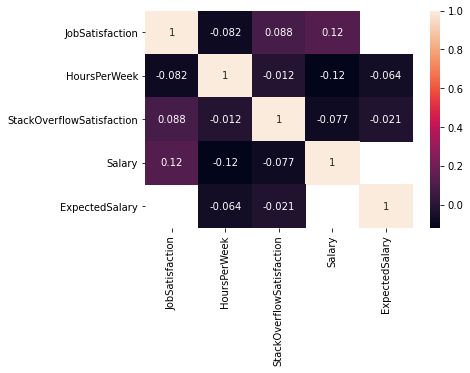

In [123]:
cols = ['JobSatisfaction',
'HoursPerWeek',
'StackOverflowSatisfaction',
'Salary',
'ExpectedSalary']
%matplotlib inline
sns.heatmap(data[cols].corr(), annot=data[cols].corr())

Zauważamy, że najlepsza korelacja to 0.12 więc jest to bardzo mała wartość. Zauważamy, że kolumny Salary i ExpectedSalary nigdy nie są wypełnione równocześnie (Oznacza to, że kolumny ExpectedSalary nie będziemy brali pod uwagę)

In [124]:
#data= data.drop(data[data.Salary.isna()].index)
#cols = ['JobSatisfaction',
#'HoursPerWeek',
#'StackOverflowSatisfaction',
#'Salary']

Sprawdzamy wartości HoursPerWeek

In [125]:
np.sort(data['HoursPerWeek'].unique())

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25.,
       26., 27., 28., 29., 30., 31., 32., 33., 34., 35., 36., 37., 38.,
       39., 40., nan])

Tworzymy boxplot w celu sprawdzenia czy możemy na nim zobaczyć zależności pomiędzy kolumną HoursPerWeek i Salary

<AxesSubplot:xlabel='HoursPerWeek', ylabel='Salary'>

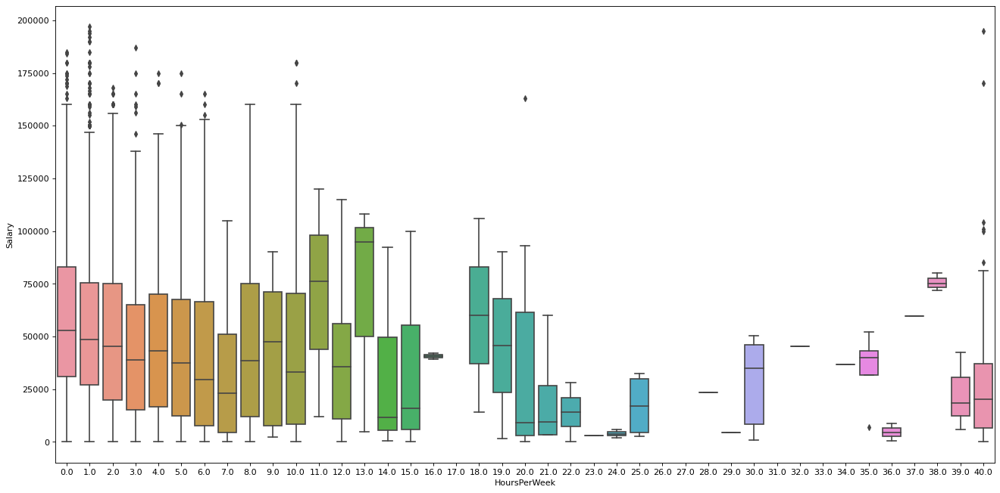

In [126]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['HoursPerWeek'], y=data['Salary'])

Tworzymy boxplot w celu sprawdzenia czy możemy na nim zobaczyć zależności pomiędzy kolumną HoursPerWeek i JobSatisfaction

<AxesSubplot:xlabel='HoursPerWeek', ylabel='JobSatisfaction'>

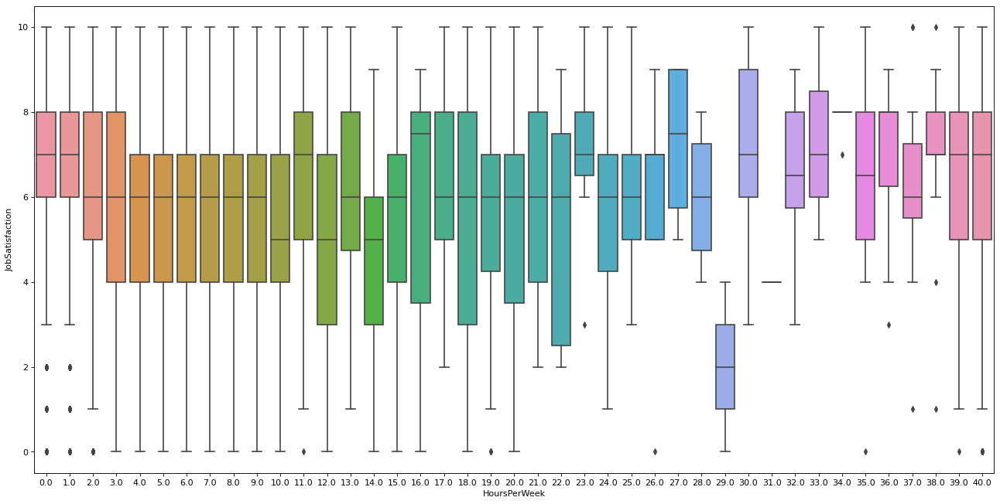

In [127]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['HoursPerWeek'], y=data['JobSatisfaction'])

Widzimy, że HoursPerWeek nie ma większego wpływu na kolumnę JobSatisfaction

Tworzymy boxplot w celu sprawdzenia czy możemy na nim zobaczyć zależności pomiędzy kolumną StackOverflowSatisfaction i Salary

<AxesSubplot:xlabel='StackOverflowSatisfaction', ylabel='Salary'>

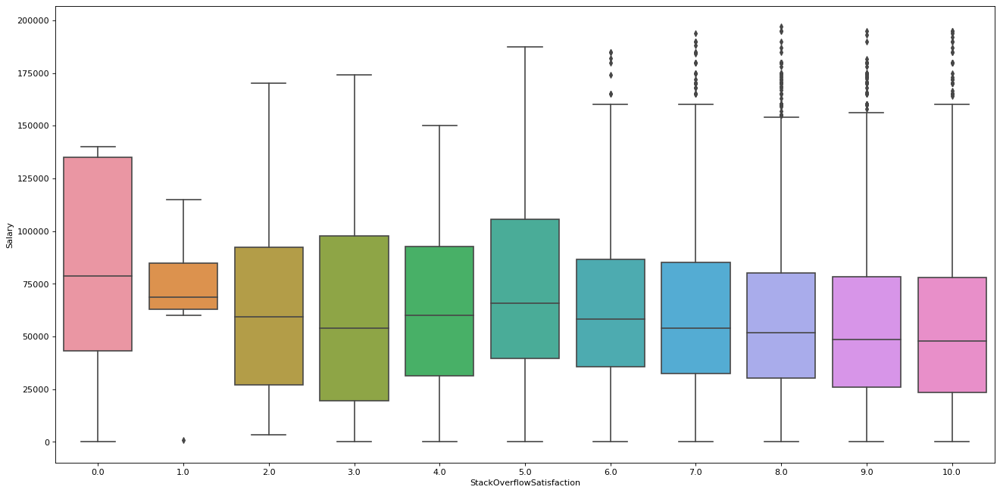

In [128]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['StackOverflowSatisfaction'], y=data['Salary'])

Zauważamy, że najwyższe wrtości pojawiają się gdy StackOverflowSatisfaction osiąga większe wartości

Tworzymy boxplot w celu sprawdzenia czy możemy na nim zobaczyć zależności pomiędzy kolumnąJobSatisfaction i Salary

<AxesSubplot:xlabel='JobSatisfaction', ylabel='Salary'>

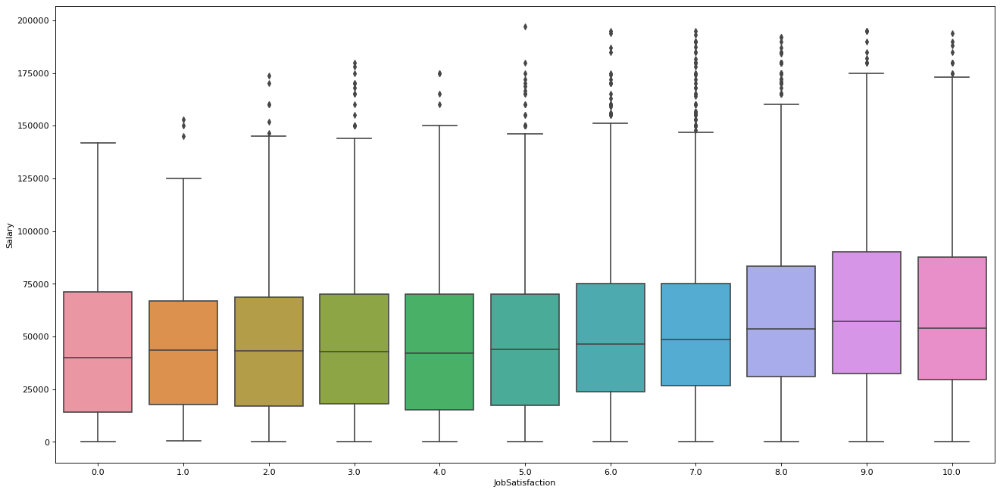

In [129]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['JobSatisfaction'], y=data['Salary'])

Brak większych zależności

Tworzymy boxplot w celu sprawdzenia czy możemy na nim zobaczyć zależności pomiędzy kolumną MinYearsCodedJob i Salary

<AxesSubplot:xlabel='MinYearsCodedJob', ylabel='Salary'>

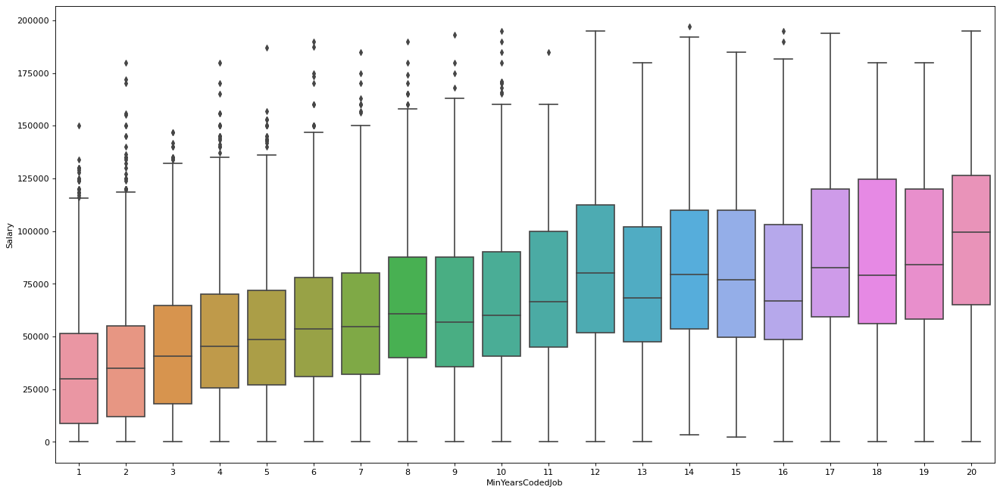

In [130]:
l = data['MinYearsCodedJob'].unique()
l = l[l != None]
l = l.astype(np.float)
l.sort()
l = ["%.2f" % number for number in l]

for i in range(len(l)):
    l[i]=l[i][:-3]

plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=data['MinYearsCodedJob'], y=data['Salary'], order = l)

Zauważamy trend, który mówi, że wzrost wynagrodzenia jest związany ze wzrostem doświadczenia developera

In [131]:
pd.set_option('display.max_rows', 10)

In [132]:
data

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,CompanyType,YearsProgram,YearsCodedJob,YearsCodedJobPast,DeveloperType,WebDeveloperType,MobileDeveloperType,NonDeveloperType,CareerSatisfaction,JobSatisfaction,ExCoderReturn,ExCoderNotForMe,ExCoderBalance,ExCoder10Years,ExCoderBelonged,ExCoderSkills,ExCoderWillNotCode,ExCoderActive,PronounceGIF,ProblemSolving,BuildingThings,LearningNewTech,BoringDetails,JobSecurity,DiversityImportant,AnnoyingUI,FriendsDevelopers,RightWrongWay,UnderstandComputers,SeriousWork,InvestTimeTools,WorkPayCare,KinshipDevelopers,ChallengeMyself,CompetePeers,ChangeWorld,JobSeekingStatus,HoursPerWeek,LastNewJob,AssessJobIndustry,AssessJobRole,AssessJobExp,AssessJobDept,AssessJobTech,AssessJobProjects,AssessJobCompensation,AssessJobOffice,AssessJobCommute,AssessJobRemote,AssessJobLeaders,AssessJobProfDevel,AssessJobDiversity,AssessJobProduct,AssessJobFinances,ImportantBenefits,ClickyKeys,JobProfile,ResumePrompted,LearnedHiring,ImportantHiringAlgorithms,ImportantHiringTechExp,ImportantHiringCommunication,ImportantHiringOpenSource,ImportantHiringPMExp,ImportantHiringCompanies,ImportantHiringTitles,ImportantHiringEducation,ImportantHiringRep,ImportantHiringGettingThingsDone,Currency,Overpaid,TabsSpaces,EducationImportant,EducationTypes,SelfTaughtTypes,TimeAfterBootcamp,CousinEducation,WorkStart,HaveWorkedLanguage,WantWorkLanguage,HaveWorkedFramework,WantWorkFramework,HaveWorkedDatabase,WantWorkDatabase,HaveWorkedPlatform,WantWorkPlatform,IDE,AuditoryEnvironment,Methodology,VersionControl,CheckInCode,ShipIt,OtherPeoplesCode,ProjectManagement,EnjoyDebugging,InTheZone,DifficultCommunication,CollaborateRemote,MetricAssess,EquipmentSatisfiedMonitors,EquipmentSatisfiedCPU,EquipmentSatisfiedRAM,EquipmentSatisfiedStorage,EquipmentSatisfiedRW,InfluenceInternet,InfluenceWorkstation,InfluenceHardware,InfluenceServers,InfluenceTechStack,InfluenceDeptTech,InfluenceVizTools,InfluenceDatabase,InfluenceCloud,InfluenceConsultants,InfluenceRecruitment,InfluenceCommunication,StackOverflowDescribes,StackOverflowSatisfaction,StackOverflowDevices,StackOverflowFoundAnswer,StackOverflowCopiedCode,StackOverflowJobListing,StackOverflowCompanyPage,StackOverflowJobSearch,StackOverflowNewQuestion,StackOverflowAnswer,StackOverflowMetaChat,StackOverflowAdsRelevant,StackOverflowAdsDistracting,StackOverflowModeration,StackOverflowCommunity,StackOverflowHelpful,StackOverflowBetter,StackOverflowWhatDo,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary,MinYearsCodedJob
0,1,Student,"Yes, both",United States,No,"Not employed, and not looking for work",Secondary school,NaN,NaN,NaN,NaN,2 to 3 years,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"With a soft ""g,"" like ""jiff""",Strongly agree,Strongly agree,Agree,Disagree,Strongly agree,Agree,Agree,Disagree,Somewhat agree,Disagree,Strongly agree,Strongly agree,Strongly disagree,Agree,Agree,Disagree,Agree,"I'm not actively looking, but I am open to new...",0.0,Not applicable/ never,Very important,Very important,Important,Very important,Very important,Very important,Important,Very important,Very important,Very important,Very important,Very important,Somewhat important,Not very important,Somewhat important,Stock options; Vacation/days off; Remote options,Yes,Other,NaN,NaN,Important,Important,Important,Somewhat important,Important,Not very important,Not very important,Not at all important,Somewhat important,Very important,NaN,NaN,Tabs,NaN,Online course; Open source contributions,NaN,NaN,NaN,6:00 AM,Swift,Swift,NaN,NaN,NaN,NaN,iOS,iOS,Atom; Xcode,Turn on some music,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Somewhat satisfied,Not very satisfied,Not at all satisfied,Very satisfied,Satisfied,Not very satisfied,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I have created a CV or Developer Story on Stac...,9.0,Desktop

Sprawdzenie wymiarów naszych dataframe

Usunięcie kolumn składających się z samych wartości NaN

In [133]:
#data = data.dropna(how='all', axis=1)

In [134]:
#rodzaje zawodów
print(data["Professional"].unique().tolist())
print('There are {} unique Professional in the provided dataset'.format(len(data['Professional'].unique().tolist())))

['Student', 'Professional developer', 'Professional non-developer who sometimes writes code', 'Used to be a professional developer', 'None of these']
There are 5 unique Professional in the provided dataset


Text(0.5, 1.0, 'What kind of developer are you?')

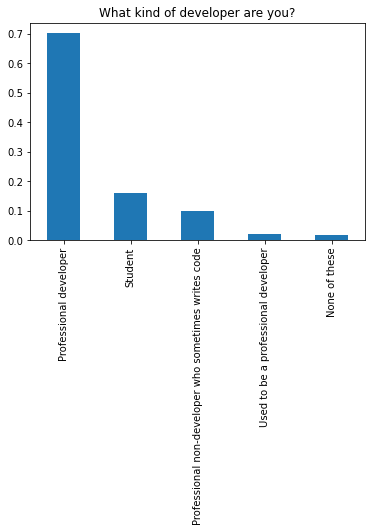

In [135]:
%matplotlib inline
professional_stats=data['Professional'].value_counts()
(professional_stats/data.shape[0]).plot(kind='bar')
plt.title("What kind of developer are you?")

In [136]:
#rodzaje edukacji
print(data['FormalEducation'].unique().tolist())

['Secondary school', "Some college/university study without earning a bachelor's degree", "Bachelor's degree", 'Doctoral degree', "Master's degree", 'Professional degree', 'Primary/elementary school', 'I prefer not to answer', 'I never completed any formal education']


Text(0.5, 1.0, 'Formal Education')

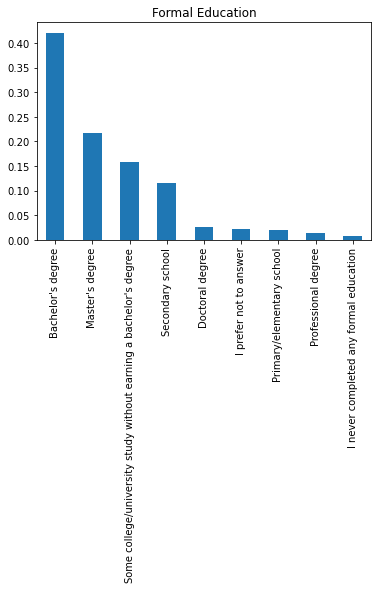

In [137]:
Formaledu_stats=data['FormalEducation'].value_counts()
(Formaledu_stats/data.shape[0]).plot(kind='bar')
plt.title("Formal Education")

In [138]:
data[cols]

,JobSatisfaction,HoursPerWeek,StackOverflowSatisfaction,Salary,ExpectedSalary
0,NaN,0.0,9.0,NaN,NaN
1,NaN,NaN,8.0,NaN,37500.0
2,9.0,NaN,8.0,113750.0,NaN
3,3.0,5.0,10.0,NaN,NaN
4,8.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...
51387,3.0,5.0,9.0,58000.0,NaN
51388,NaN,NaN,7.0,NaN,NaN
51389,10.0,NaN,NaN,NaN,NaN
51390,7.0,1.0,9.0,40000.0,NaN


Usunięcie wierszy gdzie

In [139]:
df = data.drop(data[data.Salary.isna()].index)

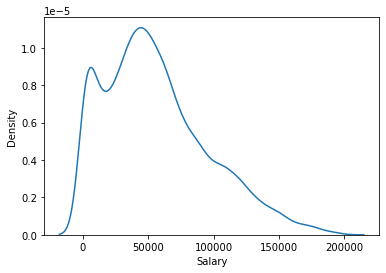

In [140]:
sns.kdeplot(data=df, x="Salary")
plt.show()

Sprawdzenie wymiarów naszego dataframe

In [141]:
data.shape

(51392, 155)

Sprawdzenie wymiarów dataframe bez wierszy z pustym polem 'Salary'

In [142]:
df.shape

(12891, 155)

In [143]:
l = [
    'FormalEducation',
    'Country',
    'Race',
    'Gender',
    'MinYearsCodedJob',
    'DeveloperType',
    'CompanySize',
    'HoursPerWeek',
    'LearningNewTech',
    'ExCoderReturn',
    'ExCoderNotForMe',
    'ExCoderBalance',
    'ExCoder10Years',
    'ExCoderBelonged',
    'ExCoderSkills',
    'ExCoderWillNotCode',
    'ExCoderActive',
    'BuildingThings',
    'BoringDetails',
    'JobSecurity',
    'DiversityImportant',
    'FriendsDevelopers',
    'CompetePeers',
    'SeriousWork',
    'CheckInCode',
    'ShipIt',
    'DifficultCommunication',
    'CollaborateRemote'
]
print(len(l))

chunk_count = 2
limit = len(l)//chunk_count
chunk1 = l[:limit]
chunk2 = l[limit:-1]
print(chunk1)
print(chunk2)
def drawboxplots(l):
    for value in l:
        plt.figure(figsize=(20,10), dpi=80)
        sns.boxplot(x=data[value], y=data['Salary'])    

28
['FormalEducation', 'Country', 'Race', 'Gender', 'MinYearsCodedJob', 'DeveloperType', 'CompanySize', 'HoursPerWeek', 'LearningNewTech', 'ExCoderReturn', 'ExCoderNotForMe', 'ExCoderBalance', 'ExCoder10Years', 'ExCoderBelonged']
['ExCoderSkills', 'ExCoderWillNotCode', 'ExCoderActive', 'BuildingThings', 'BoringDetails', 'JobSecurity', 'DiversityImportant', 'FriendsDevelopers', 'CompetePeers', 'SeriousWork', 'CheckInCode', 'ShipIt', 'DifficultCommunication']


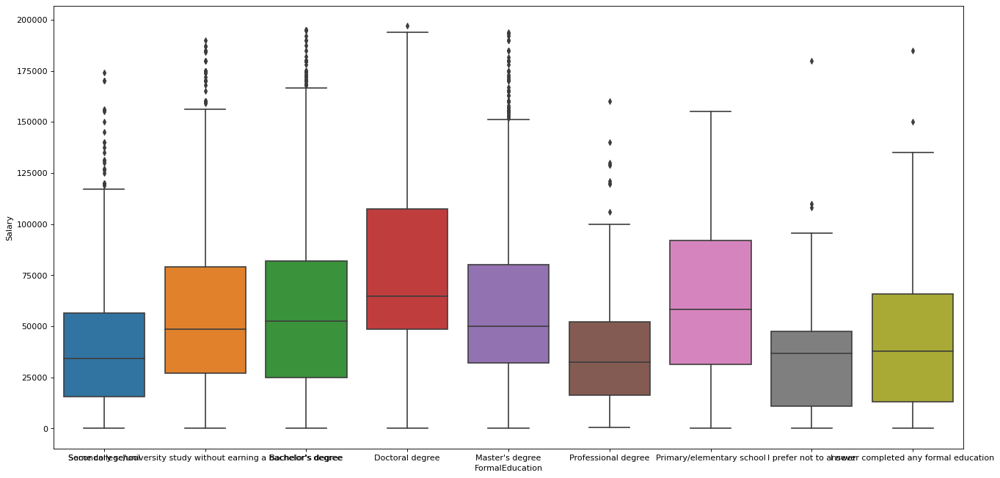

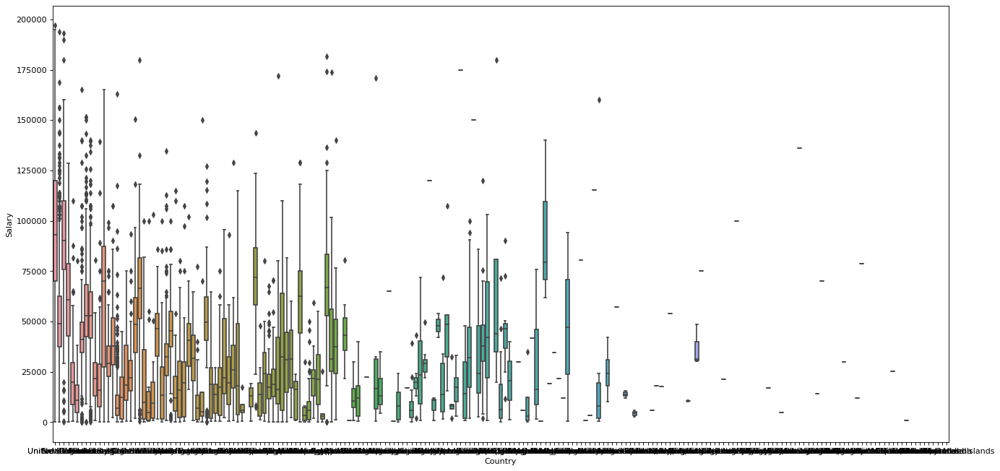

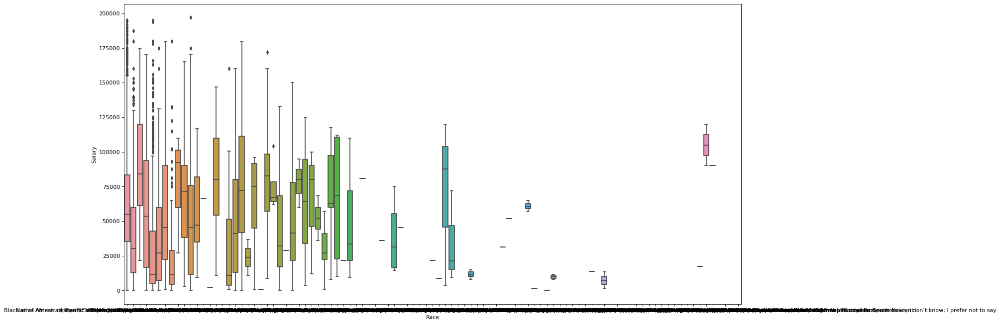

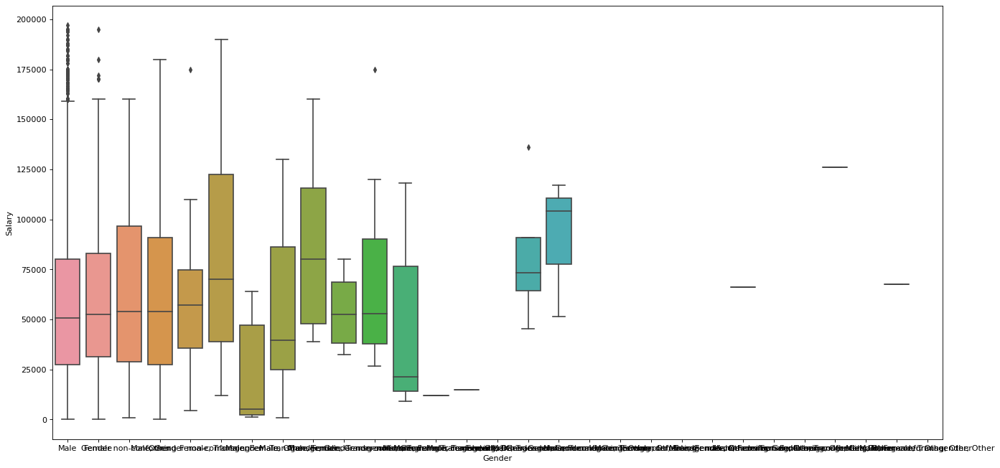

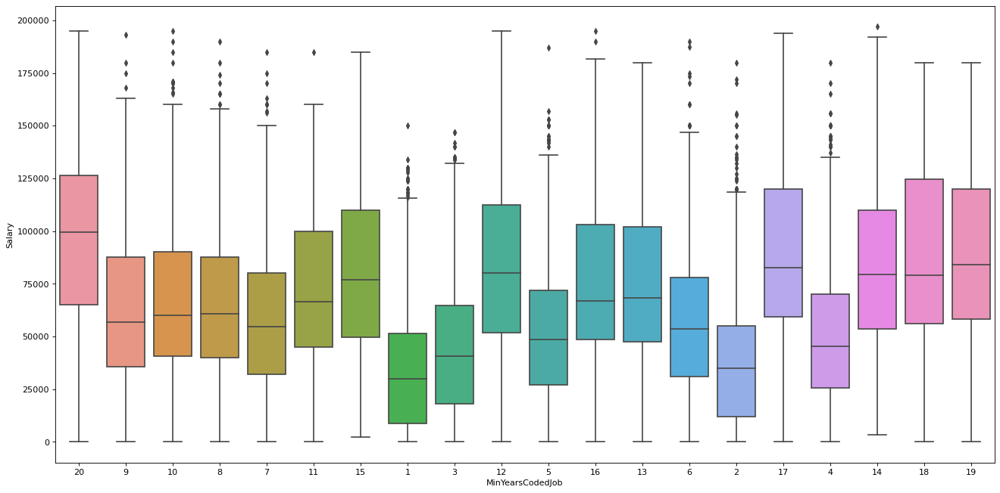

...

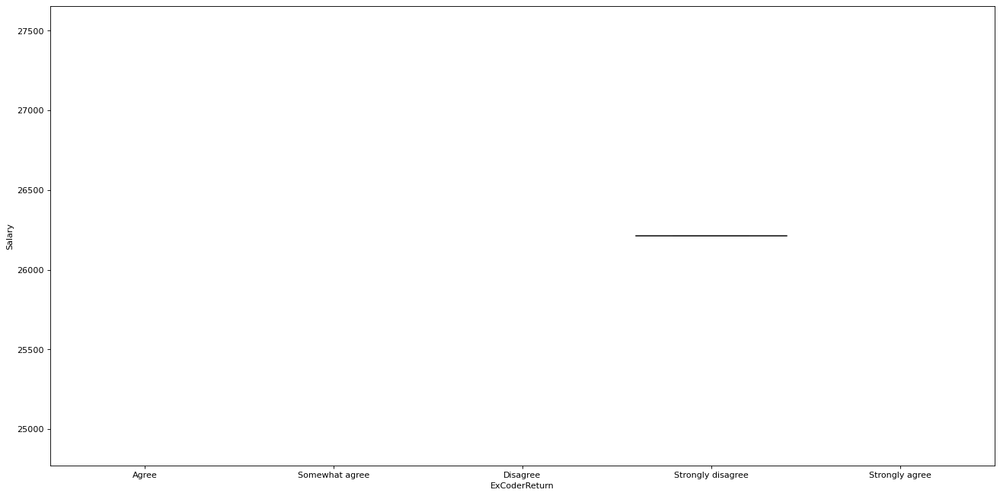

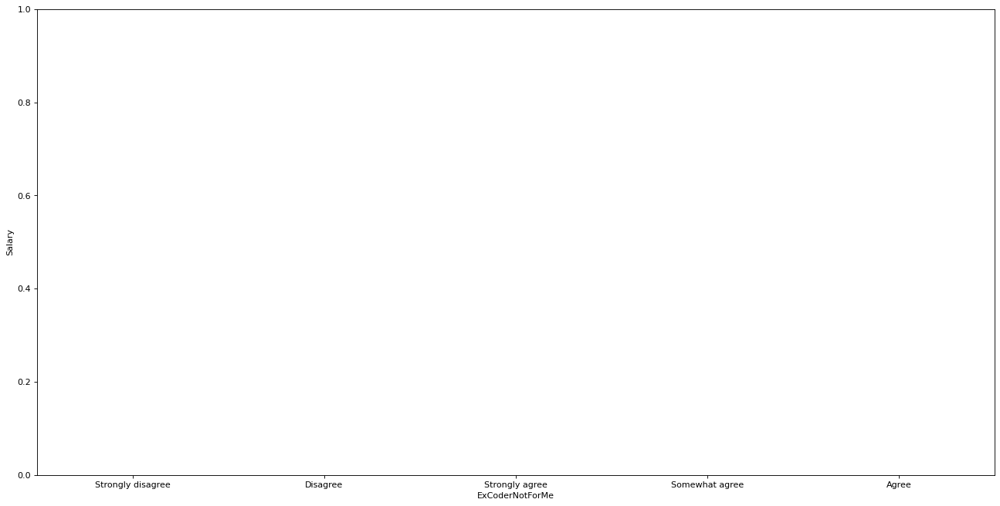

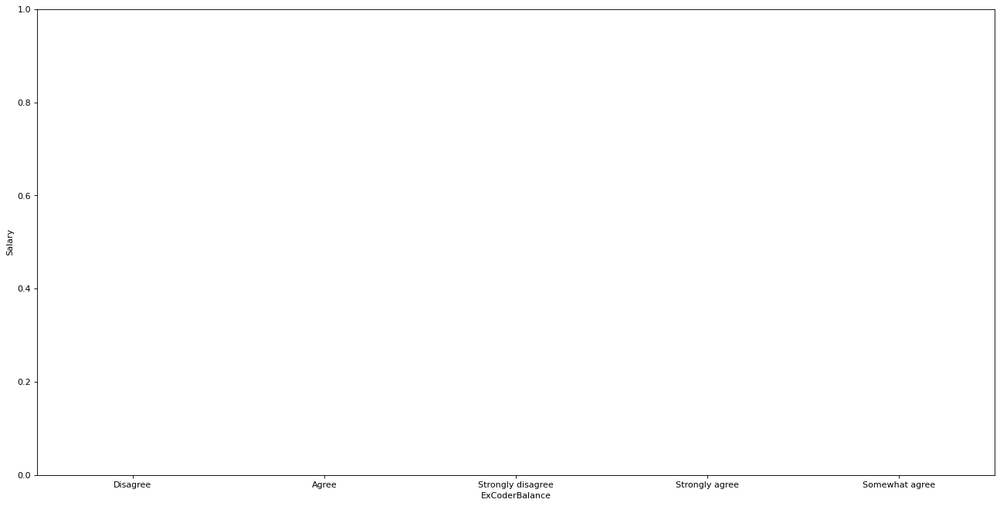

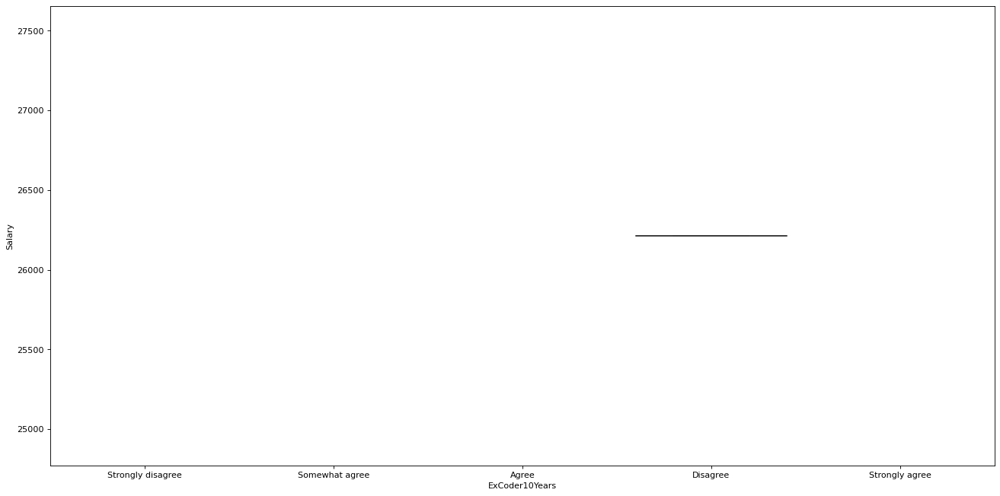

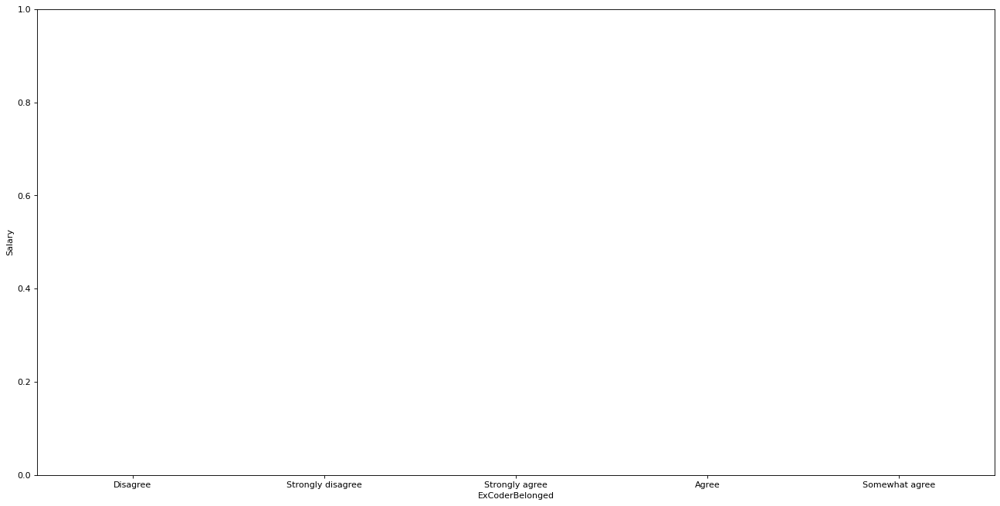

In [144]:
drawboxplots(chunk1)

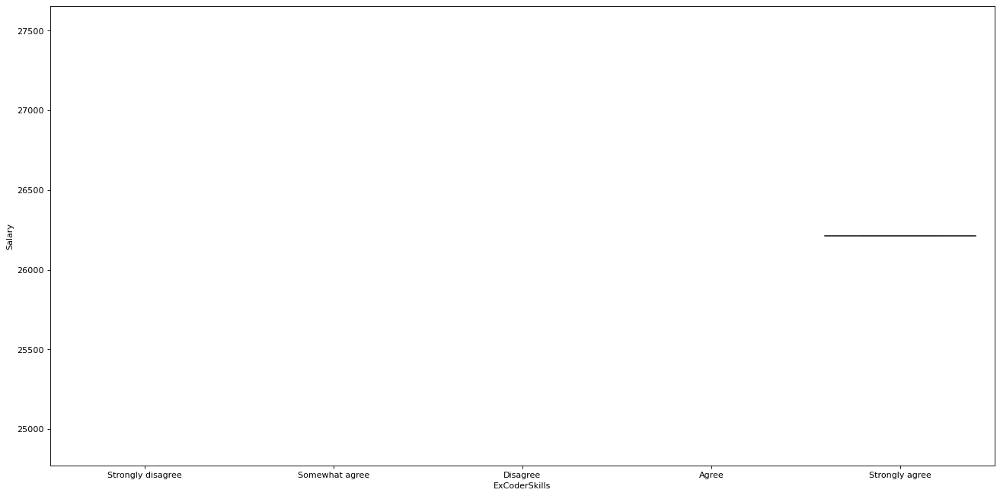

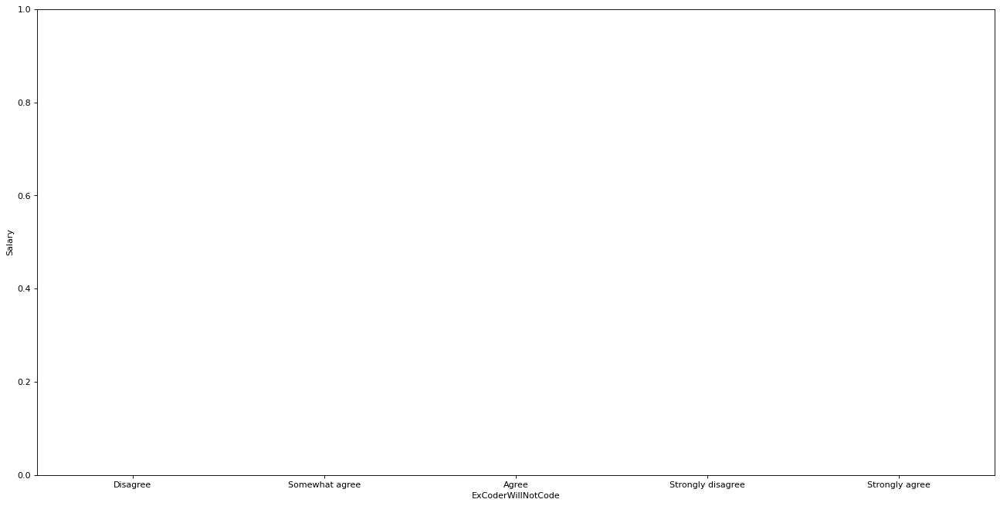

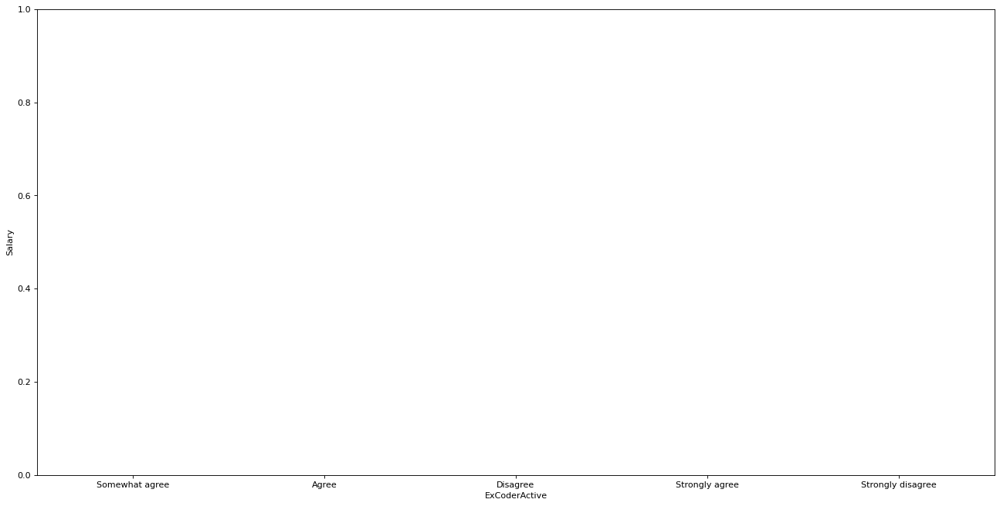

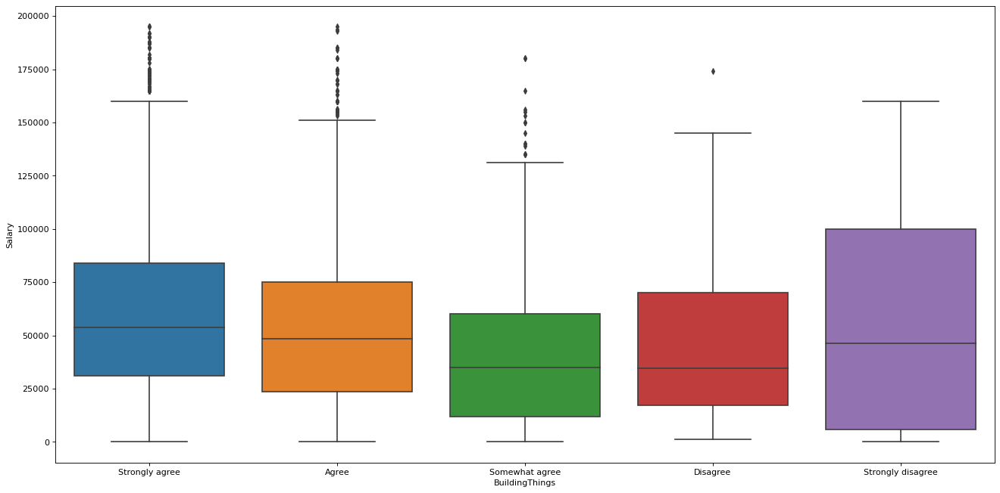

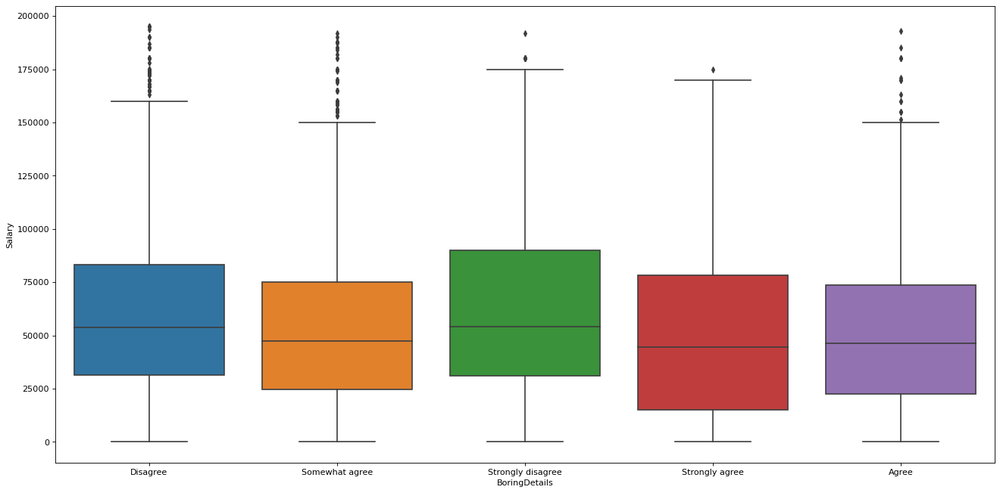

...

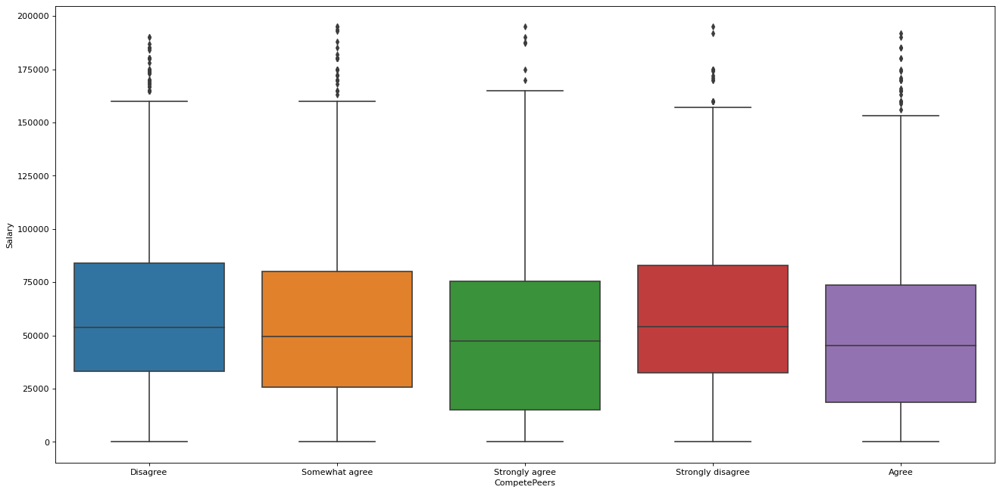

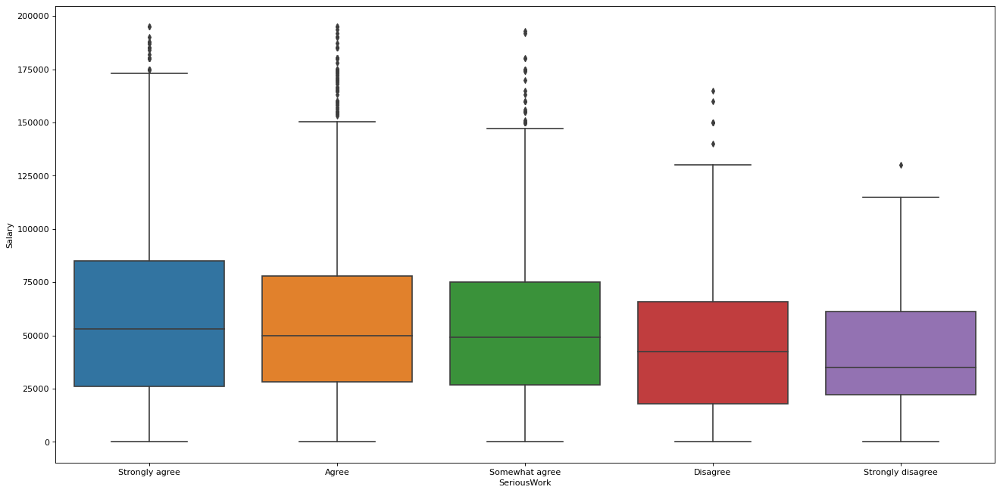

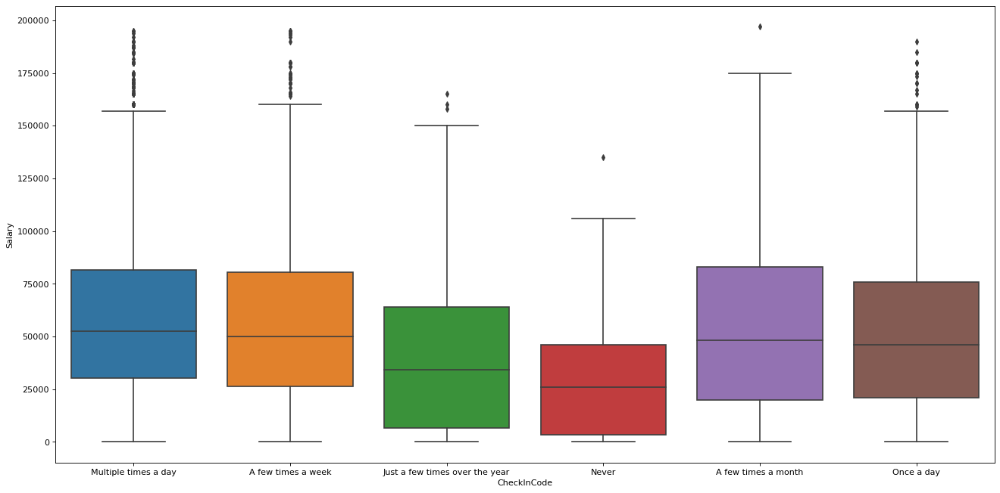

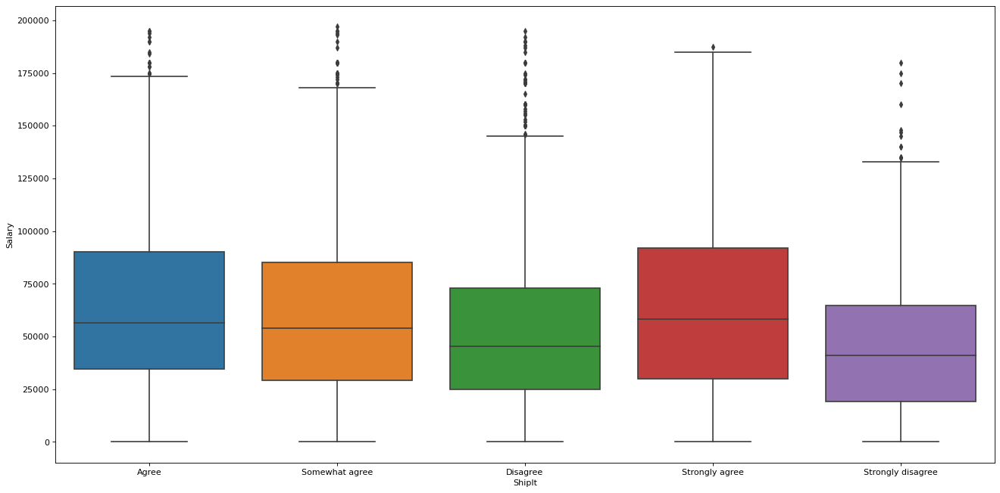

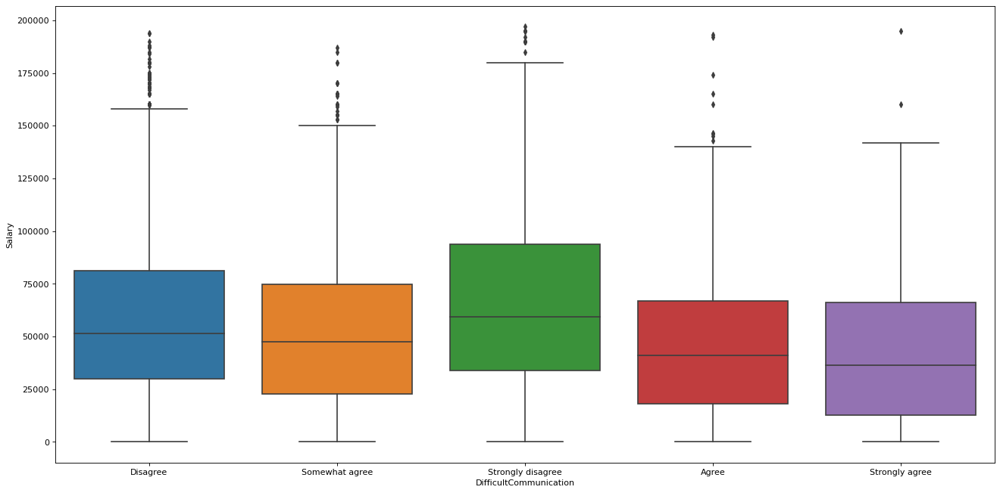

In [145]:
drawboxplots(chunk2)

Kolumny 'ExCoderReturn',
    'ExCoderNotForMe',
    'ExCoderBalance',
    'ExCoder10Years',
    'ExCoderBelonged',
    'ExCoderSkills',
    'ExCoderWillNotCode',
    'ExCoderActive'są zbędne

Wykresy dla kolumn Country, Gender, Race, DeveloperType były mało wyraźne przez zbyt dużą liczbę klas. Tworzymy wnowe wykresy by wybrać najliczniejsze klasy i do nich zawęzić naszą regresję

<AxesSubplot:ylabel='Country'>

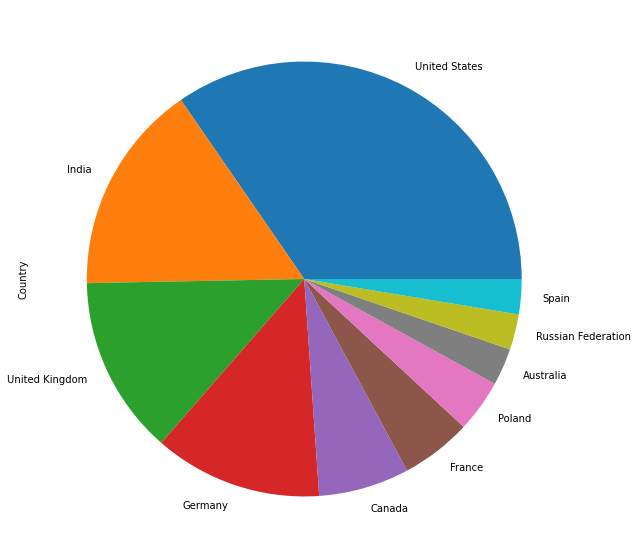

In [146]:
data['Country'].value_counts()[0:10].plot(kind='pie',figsize=(12,10))

Będziemy prowadzić nasz projekt dla 10 najpopularniejszych krajów

In [147]:
ImportantCountries = data['Country'].value_counts()[0:10].index.tolist()
ImportantCountries

['United States',
 'India',
 'United Kingdom',
 'Germany',
 'Canada',
 'France',
 'Poland',
 'Australia',
 'Russian Federation',
 'Spain']

<AxesSubplot:ylabel='Gender'>

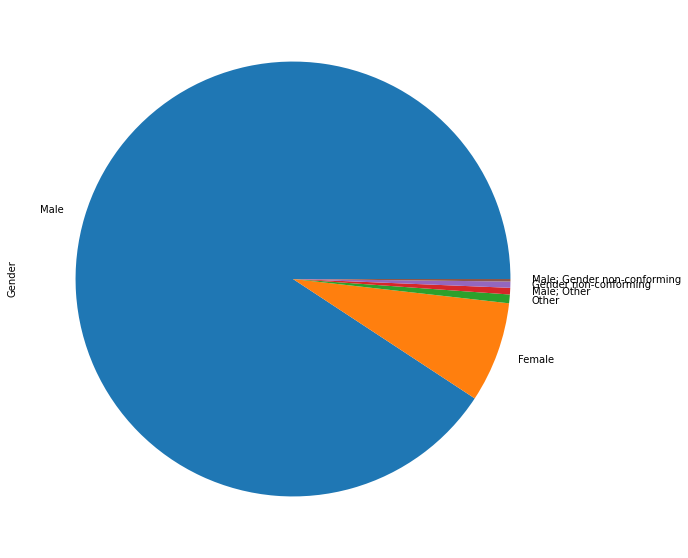

In [148]:
data['Gender'].value_counts()[0:6].plot(kind='pie',figsize=(12,10))

Projekt będzie prowadzony dla dwóch najpopularniejszych płci

In [149]:
ImportantGenders = data['Gender'].value_counts()[0:2].index.tolist()
ImportantGenders

['Male', 'Female']

<AxesSubplot:ylabel='Race'>

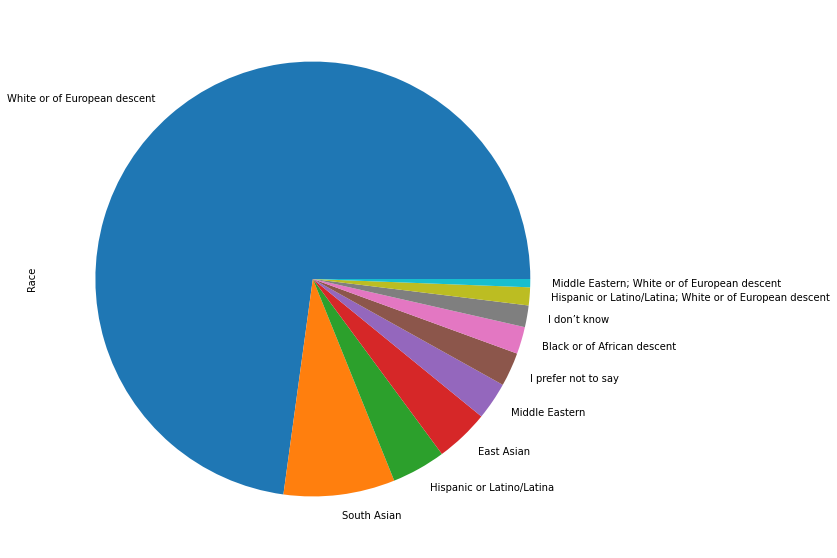

In [150]:
data['Race'].value_counts()[0:10].plot(kind='pie',figsize=(12,10))

Projekt będzie prowadzony dla 6 najpopularniejszych "ras" (bez "I prefer not to say")

In [151]:
ImportantRaces = data['Race'].value_counts()[0:7].index.tolist()
ImportantRaces.remove('I prefer not to say')
ImportantRaces


['White or of European descent',
 'South Asian',
 'Hispanic or Latino/Latina',
 'East Asian',
 'Middle Eastern',
 'Black or of African descent']

<AxesSubplot:ylabel='DeveloperType'>

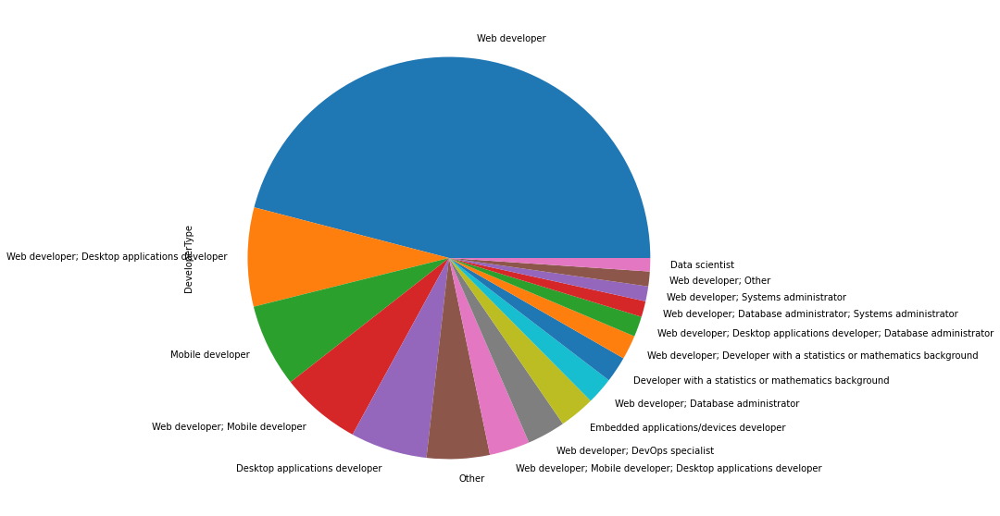

In [152]:
data['DeveloperType'].value_counts()[0:17].plot(kind='pie',figsize=(12,10))

In [153]:
ImportantDeveloperType = data['DeveloperType'].value_counts()[0:17].index.tolist()
ImportantDeveloperType

['Web developer',
 'Web developer; Desktop applications developer',
 'Mobile developer',
 'Web developer; Mobile developer',
 'Desktop applications developer',
 'Other',
 'Web developer; Mobile developer; Desktop applications developer',
 'Web developer; DevOps specialist',
 'Embedded applications/devices developer',
 'Web developer; Database administrator',
 'Developer with a statistics or mathematics background',
 'Web developer; Developer with a statistics or mathematics background',
 'Web developer; Desktop applications developer; Database administrator',
 'Web developer; Database administrator; Systems administrator',
 'Web developer; Systems administrator',
 'Web developer; Other',
 'Data scientist']

Projekt będzie prowadzony dla kilku najpopularniejszych typów developera

Tworzenie finalnego dataframe

In [154]:
data = pd.read_csv('survey_results_public.csv')
schema=pd.read_csv('survey_results_schema.csv')
data['MinYearsCodedJob'] = data['YearsCodedJob'].apply(lambda x: x.split()[0] if not pd.isnull(x) else None)
data['MinYearsCodedJob'] = data['MinYearsCodedJob'].apply(lambda x: None if x == 'Less' else x)

Wybranie cech, które MOGĄ okazać się ważne

In [155]:
data = data.drop(data[data.Salary.isna()].index)
ImportantColumns = [
    'FormalEducation',
    'Country',
    'Race',
    'Gender',
    'MinYearsCodedJob',
    'DeveloperType',
    'CompanySize',
    'HoursPerWeek',
    'LearningNewTech',
    'BuildingThings',
    'BoringDetails',
    'JobSecurity',
    'DiversityImportant',
    'FriendsDevelopers',
    'CompetePeers',
    'SeriousWork',
    'CheckInCode',
    'ShipIt',
    'DifficultCommunication',
    'CollaborateRemote',
    'StackOverflowSatisfaction',
    'JobSatisfaction',
    'Salary'
]
data = data[data['Country'].isin(ImportantCountries)]
data = data[data['Gender'].isin(ImportantGenders)]
data = data[data['Race'].isin(ImportantRaces)]
data = data[data['DeveloperType'].isin(ImportantDeveloperType)]
data = data[ImportantColumns]

In [156]:
data.shape

(4846, 23)

In [157]:
data.tail()

,FormalEducation,Country,Race,Gender,MinYearsCodedJob,DeveloperType,CompanySize,HoursPerWeek,LearningNewTech,BuildingThings,BoringDetails,JobSecurity,DiversityImportant,FriendsDevelopers,CompetePeers,SeriousWork,CheckInCode,ShipIt,DifficultCommunication,CollaborateRemote,StackOverflowSatisfaction,JobSatisfaction,Salary
51328,Bachelor's degree,India,South Asian,Male,5,Web developer,Fewer than 10 employees,NaN,Strongly agree,Agree,Disagree,Agree,Agree,Agree,Somewhat agree,Strongly agree,A few times a week,Agree,Strongly disagree,Disagree,9.0,8.0,4404.639554
51335,Secondary school,United Kingdom,White or of European descent,Male,8,Web developer; Desktop applications developer,"1,000 to 4,999 employees",2.0,Strongly agree,Strongly agree,Disagree,Agree,Somewhat agree,Strongly disagree,Agree,Agree,Multiple times a day,Agree,Somewhat agree,Disagree,9.0,9.0,88750.000000
51355,Bachelor's degree,United Kingdom,White or of European descent,Male,1,Web developer,100 to 499 employees,4.0,Strongly agree,Strongly agree,Somewhat agree,Agree,Agree,Somewhat agree,Somewhat agree,Agree,Multiple times a day,Somewhat agree,Disagree,Agree,10.0,5.0,33750.000000
51382,Master's degree,France,White or of European descent,Male,1,Web developer,100 to 499 employees,0.0,Agree,Strongly agree,Somewhat agree,Agree,Agree,Agree,Agree,Strongly agree,NaN,NaN,NaN,NaN,7.0,5.0,32258.064516
51390,Bachelor's degree,United States,White or of European descent,Male,3,Web developer; Mobile developer,Fewer than 10 employees,1.0,Strongly agree,Agree,Strongly disagree,Somewhat agree,Disagree,Disagree,Disagree,Strongly agree,A few times a week,Disagree,Disagree,Agree,9.0,7.0,40000.000000


Usunięcie wierszy w których połowa wartości to NaN

In [158]:
data = data[data.isnull().sum(axis=1) < len(ImportantColumns)//2]

Sprawdzenie aktualnych wymiarów ramki

In [159]:
data.shape

(4544, 23)

Zamiana wartości NAN na 0

In [160]:
data = data.fillna('0')
data.head()

,FormalEducation,Country,Race,Gender,MinYearsCodedJob,DeveloperType,CompanySize,HoursPerWeek,LearningNewTech,BuildingThings,BoringDetails,JobSecurity,DiversityImportant,FriendsDevelopers,CompetePeers,SeriousWork,CheckInCode,ShipIt,DifficultCommunication,CollaborateRemote,StackOverflowSatisfaction,JobSatisfaction,Salary
2,Bachelor's degree,United Kingdom,White or of European descent,Male,20,Other,"10,000 or more employees",0,Strongly agree,Strongly agree,Somewhat agree,Agree,Strongly agree,Somewhat agree,Disagree,Agree,Multiple times a day,Agree,Disagree,Somewhat agree,8,9,113750.000000
14,Professional degree,United Kingdom,White or of European descent,Male,20,Embedded applications/devices developer,"5,000 to 9,999 employees",0,Agree,Strongly agree,Disagree,Somewhat agree,Somewhat agree,Somewhat agree,Somewhat agree,Agree,Multiple times a day,Disagree,Disagree,Somewhat agree,8,8,100000.000000
25,Master's degree,United States,White or of European descent,Male,16,Web developer,"10,000 or more employees",0,Strongly agree,Strongly agree,Strongly disagree,Agree,Strongly agree,Strongly agree,Somewhat agree,Strongly agree,0,0,0,0,9,7,175000.000000
37,Some college/university study without earning ...,Germany,White or of European descent,Male,7,Web developer,100 to 499 employees,1,Agree,Agree,Strongly disagree,Agree,0,0,0,0,A few times a month,Somewhat agree,Disagree,Disagree,8,0,118279.569892
61,Bachelor's degree,India,South Asian,Male,1,Web developer,"5,000 to 9,999 employees",0,Agree,Somewhat agree,Agree,Strongly agree,Agree,Agree,Agree,Strongly agree,Once a day,Strongly disagree,Agree,Agree,9,5,6636.323594


In [161]:
print(sorted(data['Country'].unique()))

['Australia', 'Canada', 'France', 'Germany', 'India', 'Poland', 'Russian Federation', 'Spain', 'United Kingdom', 'United States']


Zamiana kolumny Country na zmienne porządkowe <br>
**Country** <br>
India -> 0 <br>
Russian Federation -> 1 <br>
Poland -> 2<br>
Spain -> 3<br>
United Kingdom->4<br>
France -> 5<br>
Canada -> 6<br>
Germany -> 7<br>
Australia -> 8<br>
United States ->9<br>


In [162]:
from sklearn.preprocessing import OrdinalEncoder
data["Country"].mask(data["Country"] == 'India', 0, inplace=True)
data["Country"].mask(data["Country"] == 'Russian Federation', 1, inplace=True)
data["Country"].mask(data["Country"] == 'Poland', 2, inplace=True)
data["Country"].mask(data["Country"] == 'Spain', 3, inplace=True)
data["Country"].mask(data["Country"] == 'United Kingdom', 4, inplace=True)
data["Country"].mask(data["Country"] == 'France', 5, inplace=True)
data["Country"].mask(data["Country"] == 'Canada', 6, inplace=True)
data["Country"].mask(data["Country"] == 'Germany', 7, inplace=True)
data["Country"].mask(data["Country"] == 'Australia', 8, inplace=True)
data["Country"].mask(data["Country"] == 'United States', 9, inplace=True)

data["Country"] = data["Country"].astype(int)

In [163]:
#from sklearn.preprocessing import OrdinalEncoder
#pd.set_option("max_rows", 100)
#ord_enc = OrdinalEncoder()
#data["Country"] = ord_enc.fit_transform(data[["Country"]])
#data[["Country"]]

Sprawdzenie jakie wartości przyjmuje kolumna gender

In [164]:
print(sorted(data['Gender'].unique()))

['Female', 'Male']


Zamiana kolumny gender na zmienne porządkowe <br>
**Gender** <br>
Female -> 0 <br>
Male -> 1

In [165]:
ord_enc = OrdinalEncoder()
data["Gender"] = ord_enc.fit_transform(data[["Gender"]])
data[["Gender"]]

,Gender
2,1.0
14,1.0
25,1.0
37,1.0
61,1.0
...,...
51328,1.0
51335,1.0
51355,1.0
51382,1.0


In [166]:
data

,FormalEducation,Country,Race,Gender,MinYearsCodedJob,DeveloperType,CompanySize,HoursPerWeek,LearningNewTech,BuildingThings,BoringDetails,JobSecurity,DiversityImportant,FriendsDevelopers,CompetePeers,SeriousWork,CheckInCode,ShipIt,DifficultCommunication,CollaborateRemote,StackOverflowSatisfaction,JobSatisfaction,Salary
2,Bachelor's degree,4,White or of European descent,1.0,20,Other,"10,000 or more employees",0,Strongly agree,Strongly agree,Somewhat agree,Agree,Strongly agree,Somewhat agree,Disagree,Agree,Multiple times a day,Agree,Disagree,Somewhat agree,8,9,113750.000000
14,Professional degree,4,White or of European descent,1.0,20,Embedded applications/devices developer,"5,000 to 9,999 employees",0,Agree,Strongly agree,Disagree,Somewhat agree,Somewhat agree,Somewhat agree,Somewhat agree,Agree,Multiple times a day,Disagree,Disagree,Somewhat agree,8,8,100000.000000
25,Master's degree,9,White or of European descent,1.0,16,Web developer,"10,000 or more employees",0,Strongly agree,Strongly agree,Strongly disagree,Agree,Strongly agree,Strongly agree,Somewhat agree,Strongly agree,0,0,0,0,9,7,175000.000000
37,Some college/university study without earning ...,7,White or of European descent,1.0,7,Web developer,100 to 499 employees,1,Agree,Agree,Strongly disagree,Agree,0,0,0,0,A few times a month,Somewhat agree,Disagree,Disagree,8,0,118279.569892
61,Bachelor's degree,0,South Asian,1.0,1,Web developer,"5,000 to 9,999 employees",0,Agree,Somewhat agree,Agree,Strongly agree,Agree,Agree,Agree,Strongly agree,Once a day,Strongly disagree,Agree,Agree,9,5,6636.323594
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51328,Bachelor's degree,0,South Asian,1.0,5,Web developer,Fewer than 10 employees,0,Strongly agree,Agree,Disagree,Agree,Agree,Agree,Somewhat agree,Strongly agree,A few times a week,Agree,Strongly disagree,Disagree,9,8,4404.639554
51335,Secondary school,4,White or of European descent,1.0,8,Web developer; Desktop applications developer,"1,000 to 4,999 employees",2,Strongly agree,Strongly agree,Disagree,Agree,Somewhat agree,Strongly disagree,Agree,Agree,Multiple times a day,Agree,Somewhat agree,Disagree,9,9,88750.000000
51355,Bachelor's degree,4,White or of European descent,1.0,1,Web developer,100 to 499 employees,4,Strongly agree,Strongly agree,Somewhat agree,Agree,Agree,Somewhat agree,Somewhat agree,Agree,Multiple times a day,Somewhat agree,Disagree,Agree,10,5,33750.000000
51382,Master's degree,5,White or of European descent,1.0,1,Web developer,100 to 499 employees,0,Agree,Strongly agree,Somewhat agree,Agree,Agree,Agree,Agree,Strongly agree,0,0,0,0,7,5,32258.064516


Podział kolumn na te, które możemy zamienić na porządkowe (ComparableColumns) oraz te, których nie możemy(NotComparableColumns)

In [167]:
ComparableColumns = [
    'MinYearsCodedJob',
    'CompanySize',
    'HoursPerWeek',
    'LearningNewTech',
    'BuildingThings',
    'BoringDetails',
    'JobSecurity',
    'DiversityImportant',
    'FriendsDevelopers',
    'CompetePeers',
    'SeriousWork',
    'CheckInCode',
    'ShipIt',
    'DifficultCommunication',
    'CollaborateRemote',
    'StackOverflowSatisfaction',
    'JobSatisfaction', 
]
NotComparableColumns =[
    'FormalEducation',
    'Race',
    'DeveloperType'
]


Sprawdzenie jakei wartości występują w badanych kolumnach

In [168]:
for val in NotComparableColumns:
    print(data[val].nunique())
    print(sorted(data[val].unique()))
    data[val] = ord_enc.fit_transform(data[[val]])
    print()

9
["Bachelor's degree", 'Doctoral degree', 'I never completed any formal education', 'I prefer not to answer', "Master's degree", 'Primary/elementary school', 'Professional degree', 'Secondary school', "Some college/university study without earning a bachelor's degree"]

6
['Black or of African descent', 'East Asian', 'Hispanic or Latino/Latina', 'Middle Eastern', 'South Asian', 'White or of European descent']

17
['Data scientist', 'Desktop applications developer', 'Developer with a statistics or mathematics background', 'Embedded applications/devices developer', 'Mobile developer', 'Other', 'Web developer', 'Web developer; Database administrator', 'Web developer; Database administrator; Systems administrator', 'Web developer; Desktop applications developer', 'Web developer; Desktop applications developer; Database administrator', 'Web developer; DevOps specialist', 'Web developer; Developer with a statistics or mathematics background', 'Web developer; Mobile developer', 'Web develope

Opis zmian w kolumnach (porządek alfabetyczny)

**FormalEducation** <br>
Bachelor's degree -> 0 <br>
Doctoral degree -> 1<br>
I never completed any formal education -> 2<br>
I prefer not to answer -> 3<br>
Master's degree -> 4<br>
Primary/elementary school -> 5<br>
Professional degree -> 6<br>
Secondary school -> 7<br>
ome college/university study without earning a bachelor's degree - > 8

**Race** <br>
Black or of African descent -> 0 <br>
East Asian -> 1 <br>
Hispanic or Latino/Latina -> 2<br>
Middle Eastern -> 3 <br>
South Asia -> 5<br>
White or of European descent-> 6

**DeveloperType** <br>
Data scientist -> 0 <br>
Desktop applications developer -> 1 <br>
Developer with a statistics or mathematics background -> 2 <br>
Embedded applications/devices developer -> 3 <br>
Mobile developer -> 4 <br>
Other -> 5 <br>
Web developer -> 6 <br>
Web developer; Database administrator -> 7 <br>
Web developer; Database administrator; Systems administrator -> 8 <br>
Web developer; Desktop applications developer -> 9 <br>
Web developer; Desktop applications developer; Database administrator -> 10 <br>
Web developer; DevOps specialist -> 11 <br>
Web developer; Developer with a statistics or mathematics background -> 12 <br>
Web developer; Mobile developer -> 13 <br>
Web developer; Mobile developer; Desktop applications developer -> 14 <br>
Web developer; Other -> 15 <br>
Web developer; Systems administrator -> 16


Zamiana kolumny MinYearsCodedJob z string na int

In [169]:
data['MinYearsCodedJob'] = data['MinYearsCodedJob'].astype(int)
data.head()

,FormalEducation,Country,Race,Gender,MinYearsCodedJob,DeveloperType,CompanySize,HoursPerWeek,LearningNewTech,BuildingThings,BoringDetails,JobSecurity,DiversityImportant,FriendsDevelopers,CompetePeers,SeriousWork,CheckInCode,ShipIt,DifficultCommunication,CollaborateRemote,StackOverflowSatisfaction,JobSatisfaction,Salary
2,0.0,4,5.0,1.0,20,5.0,"10,000 or more employees",0,Strongly agree,Strongly agree,Somewhat agree,Agree,Strongly agree,Somewhat agree,Disagree,Agree,Multiple times a day,Agree,Disagree,Somewhat agree,8,9,113750.000000
14,6.0,4,5.0,1.0,20,3.0,"5,000 to 9,999 employees",0,Agree,Strongly agree,Disagree,Somewhat agree,Somewhat agree,Somewhat agree,Somewhat agree,Agree,Multiple times a day,Disagree,Disagree,Somewhat agree,8,8,100000.000000
25,4.0,9,5.0,1.0,16,6.0,"10,000 or more employees",0,Strongly agree,Strongly agree,Strongly disagree,Agree,Strongly agree,Strongly agree,Somewhat agree,Strongly agree,0,0,0,0,9,7,175000.000000
37,8.0,7,5.0,1.0,7,6.0,100 to 499 employees,1,Agree,Agree,Strongly disagree,Agree,0,0,0,0,A few times a month,Somewhat agree,Disagree,Disagree,8,0,118279.569892
61,0.0,0,4.0,1.0,1,6.0,"5,000 to 9,999 employees",0,Agree,Somewhat agree,Agree,Strongly agree,Agree,Agree,Agree,Strongly agree,Once a day,Strongly disagree,Agree,Agree,9,5,6636.323594


Przerobienie kolumny CompanySize na int

In [170]:
data['CompanySize'].unique()

array(['10,000 or more employees', '5,000 to 9,999 employees',
       '100 to 499 employees', '20 to 99 employees',
       '1,000 to 4,999 employees', '10 to 19 employees',
       'Fewer than 10 employees', '500 to 999 employees', "I don't know",
       'I prefer not to answer', '0'], dtype=object)

In [171]:
BadAnswersCompany = ['I don\'t know', 'I prefer not to answer', '0']
data.loc[data['CompanySize'] == 'Fewer than 10 employees', 'CompanySize'] = '1 to 10'
data = data[~data['CompanySize'].isin(BadAnswersCompany)]


In [172]:
data['CompanySize'] = data['CompanySize'].apply(lambda x: x.split()[0] if not pd.isnull(x) else None)
data['CompanySize']= data['CompanySize'].apply(lambda x: None if x == 'Less' else x)
data['CompanySize'] = data['CompanySize'].str.replace(r',', '').astype(int)

<ipython-input-172-ee9bae97638c>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['CompanySize'] = data['CompanySize'].apply(lambda x: x.split()[0] if not pd.isnull(x) else None)
<ipython-input-172-ee9bae97638c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['CompanySize']= data['CompanySize'].apply(lambda x: None if x == 'Less' else x)
<ipython-input-172-ee9bae97638c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_in

In [173]:
data

,FormalEducation,Country,Race,Gender,MinYearsCodedJob,DeveloperType,CompanySize,HoursPerWeek,LearningNewTech,BuildingThings,BoringDetails,JobSecurity,DiversityImportant,FriendsDevelopers,CompetePeers,SeriousWork,CheckInCode,ShipIt,DifficultCommunication,CollaborateRemote,StackOverflowSatisfaction,JobSatisfaction,Salary
2,0.0,4,5.0,1.0,20,5.0,10000,0,Strongly agree,Strongly agree,Somewhat agree,Agree,Strongly agree,Somewhat agree,Disagree,Agree,Multiple times a day,Agree,Disagree,Somewhat agree,8,9,113750.000000
14,6.0,4,5.0,1.0,20,3.0,5000,0,Agree,Strongly agree,Disagree,Somewhat agree,Somewhat agree,Somewhat agree,Somewhat agree,Agree,Multiple times a day,Disagree,Disagree,Somewhat agree,8,8,100000.000000
25,4.0,9,5.0,1.0,16,6.0,10000,0,Strongly agree,Strongly agree,Strongly disagree,Agree,Strongly agree,Strongly agree,Somewhat agree,Strongly agree,0,0,0,0,9,7,175000.000000
37,8.0,7,5.0,1.0,7,6.0,100,1,Agree,Agree,Strongly disagree,Agree,0,0,0,0,A few times a month,Somewhat agree,Disagree,Disagree,8,0,118279.569892
61,0.0,0,4.0,1.0,1,6.0,5000,0,Agree,Somewhat agree,Agree,Strongly agree,Agree,Agree,Agree,Strongly agree,Once a day,Strongly disagree,Agree,Agree,9,5,6636.323594
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51328,0.0,0,4.0,1.0,5,6.0,1,0,Strongly agree,Agree,Disagree,Agree,Agree,Agree,Somewhat agree,Strongly agree,A few times a week,Agree,Strongly disagree,Disagree,9,8,4404.639554
51335,7.0,4,5.0,1.0,8,9.0,1000,2,Strongly agree,Strongly agree,Disagree,Agree,Somewhat agree,Strongly disagree,Agree,Agree,Multiple times a day,Agree,Somewhat agree,Disagree,9,9,88750.000000
51355,0.0,4,5.0,1.0,1,6.0,100,4,Strongly agree,Strongly agree,Somewhat agree,Agree,Agree,Somewhat agree,Somewhat agree,Agree,Multiple times a day,Somewhat agree,Disagree,Agree,10,5,33750.000000
51382,4.0,5,5.0,1.0,1,6.0,100,0,Agree,Strongly agree,Somewhat agree,Agree,Agree,Agree,Agree,Strongly agree,0,0,0,0,7,5,32258.064516


Sprawdzenie jakiego typu są aktualne kolumny

In [174]:
data.dtypes

FormalEducation              float64
Country                        int32
Race                         float64
Gender                       float64
MinYearsCodedJob               int32
                              ...   
DifficultCommunication        object
CollaborateRemote             object
StackOverflowSatisfaction     object
JobSatisfaction               object
Salary                       float64
Length: 23, dtype: object

Przerobienie kolumny HoursPerWeek na int

In [175]:
data['HoursPerWeek'].unique()

array(['0', 0.0, 1.0, 6.0, 2.0, 4.0, 40.0, 3.0, 7.0, 5.0, 12.0, 8.0, 10.0,
       14.0, 18.0, 15.0, 30.0, 35.0, 11.0, 9.0, 36.0, 24.0, 38.0, 22.0,
       39.0, 20.0, 19.0, 25.0], dtype=object)

In [176]:
data['HoursPerWeek'] = data['HoursPerWeek'].astype(int)

<ipython-input-176-9ce7c0b724d5>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['HoursPerWeek'] = data['HoursPerWeek'].astype(int)


Przerobiebie kolumny StackOverflowSatisfaction i JobSatisfaction na int

In [177]:
data['StackOverflowSatisfaction'] = data['StackOverflowSatisfaction'].astype(int)
data['JobSatisfaction'] = data['JobSatisfaction'].astype(int)

<ipython-input-177-a4e64fe047e4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['StackOverflowSatisfaction'] = data['StackOverflowSatisfaction'].astype(int)
<ipython-input-177-a4e64fe047e4>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['JobSatisfaction'] = data['JobSatisfaction'].astype(int)


In [178]:
AlreadyDone = ['MinYearsCodedJob', 'CompanySize', 'HoursPerWeek', 'StackOverflowSatisfaction', 'JobSatisfaction']
for val in AlreadyDone:
    ComparableColumns.remove(val)
print(ComparableColumns)

['LearningNewTech', 'BuildingThings', 'BoringDetails', 'JobSecurity', 'DiversityImportant', 'FriendsDevelopers', 'CompetePeers', 'SeriousWork', 'CheckInCode', 'ShipIt', 'DifficultCommunication', 'CollaborateRemote']


Wyświetlenie wartości w kolumnach, które będą zamieniane na porządkowe

In [179]:
for val in ComparableColumns:
    print(val)
    print(data[val].nunique())
    print(sorted(data[val].unique()))
    print()

LearningNewTech
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

BuildingThings
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

BoringDetails
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

JobSecurity
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

DiversityImportant
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

FriendsDevelopers
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

CompetePeers
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

SeriousWork
6
['0', 'Agree', 'Disagree', 'Somewhat agree', 'Strongly agree', 'Strongly disagree']

CheckInCode
7
['0', 'A few times a month', 'A few times a week', 'Just a few times over the year', 'Multiple times a day', 'Never', 'Once a day']

ShipIt
6
['0', 'Agree', 'Disagree', 'S

Wszystkie poza CheckInCode mają takie same możliwe odpowiedzi, więc będą zmieniane wedle tej samej reguły

In [180]:
ComparableColumns.remove('CheckInCode')

**Kolumny wypisane wyżej** <br>
Strongly disagree -> 0 <br>
Disagree -> 1 <br>
Somewhat agree/0 -> 2 <br>
Agree -> 3<br>
Strongly agree -> 4<br>


In [181]:
for val in ComparableColumns:
    data[val].mask(data[val] == 'Strongly disagree', 0, inplace=True)
    data[val].mask(data[val] == 'Disagree', 1, inplace=True)
    data[val].mask(data[val] == 'Somewhat agree', 2, inplace=True)
    data[val].mask(data[val] == '0', 2, inplace=True)
    data[val].mask(data[val] == 'Agree', 3, inplace=True)
    data[val].mask(data[val] == 'Strongly agree', 4, inplace=True)
    data[val] = data[val].astype(int)

C:\Users\user\anaconda3\lib\site-packages\pandas\core\generic.py:9004: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._where(
<ipython-input-181-1ba6a34b18f2>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[val] = data[val].astype(int)


In [182]:
pd.set_option("max_rows", 20)
data.dtypes

FormalEducation              float64
Country                        int32
Race                         float64
Gender                       float64
MinYearsCodedJob               int32
                              ...   
DifficultCommunication         int32
CollaborateRemote              int32
StackOverflowSatisfaction      int32
JobSatisfaction                int32
Salary                       float64
Length: 23, dtype: object

Przerobienie ostatniej kolumny CheckInCode

In [183]:
data['CheckInCode'].unique()

array(['Multiple times a day', '0', 'A few times a month', 'Once a day',
       'A few times a week', 'Just a few times over the year', 'Never'],
      dtype=object)

**CheckInCode**<br>
Never/0 -> 0 <br>
Just a few times over the year -> 1 <br>
A few times a month -> 2 <br>
A few times a week -> 3 <br>
Once a day -> 4 <br>
Multiple times a day -> 5 <br>

In [184]:
data['CheckInCode'].mask(data['CheckInCode'] == 'Never', 0, inplace=True)
data['CheckInCode'].mask(data['CheckInCode'] == '0', 0, inplace=True)
data['CheckInCode'].mask(data['CheckInCode'] == 'Just a few times over the year', 1, inplace=True)
data['CheckInCode'].mask(data['CheckInCode'] == 'A few times a month', 2, inplace=True)
data['CheckInCode'].mask(data['CheckInCode'] == 'A few times a week', 3, inplace=True)
data['CheckInCode'].mask(data['CheckInCode'] == 'Once a day', 4, inplace=True)
data['CheckInCode'].mask(data['CheckInCode'] == 'Multiple times a day', 5, inplace=True)
data['CheckInCode'] = data['CheckInCode'].astype(int)

<ipython-input-184-9267de016e33>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['CheckInCode'] = data['CheckInCode'].astype(int)


Sprawdzenie typu danych w ramce

In [185]:
data.dtypes

FormalEducation              float64
Country                        int32
Race                         float64
Gender                       float64
MinYearsCodedJob               int32
                              ...   
DifficultCommunication         int32
CollaborateRemote              int32
StackOverflowSatisfaction      int32
JobSatisfaction                int32
Salary                       float64
Length: 23, dtype: object

Zauważamy, że wszystkie kolumny nadają się do regresji

In [186]:
data.head()

,FormalEducation,Country,Race,Gender,MinYearsCodedJob,DeveloperType,CompanySize,HoursPerWeek,LearningNewTech,BuildingThings,BoringDetails,JobSecurity,DiversityImportant,FriendsDevelopers,CompetePeers,SeriousWork,CheckInCode,ShipIt,DifficultCommunication,CollaborateRemote,StackOverflowSatisfaction,JobSatisfaction,Salary
2,0.0,4,5.0,1.0,20,5.0,10000,0,4,4,2,3,4,2,1,3,5,3,1,2,8,9,113750.000000
14,6.0,4,5.0,1.0,20,3.0,5000,0,3,4,1,2,2,2,2,3,5,1,1,2,8,8,100000.000000
25,4.0,9,5.0,1.0,16,6.0,10000,0,4,4,0,3,4,4,2,4,0,2,2,2,9,7,175000.000000
37,8.0,7,5.0,1.0,7,6.0,100,1,3,3,0,3,2,2,2,2,2,2,1,1,8,0,118279.569892
61,0.0,0,4.0,1.0,1,6.0,5000,0,3,2,3,4,3,3,3,4,4,0,3,3,9,5,6636.323594


Tworzymy heatmapę w celu sprawdzenia, które kolumny mają najlepszy wpływna Salary

<AxesSubplot:>

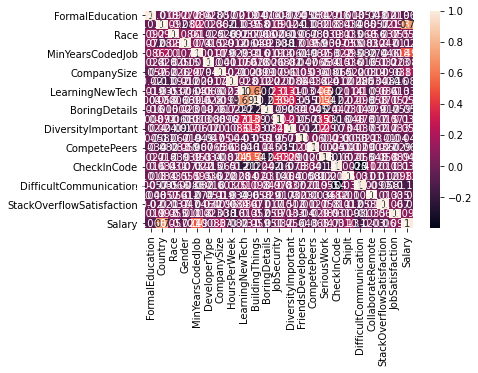

In [187]:
sns.heatmap(data.corr(), annot=data.corr())

Przestawiamy dokładniej macierz korelacji dla niżej wymienionych kolumn

<AxesSubplot:>

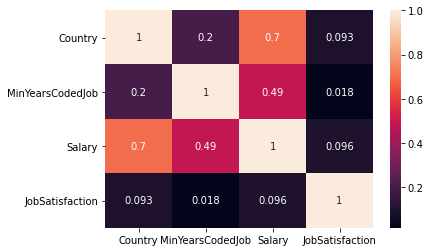

In [188]:
cols = ['Country', 'MinYearsCodedJob', 'Salary', 'JobSatisfaction']
sns.heatmap(data[cols].corr(), annot=data[cols].corr())

Pensja developera w największym stopniu powinna zależeć od Doświadczenia (MinYearsCodedJob) oraz kraju.

Usunięcie z badanych danych kolumny Salary

In [189]:
Salary = data['Salary']
data.drop('Salary', axis=1, inplace=True)

C:\Users\user\anaconda3\lib\site-packages\pandas\core\frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


Przygotowanie zbioru train i test

In [190]:
import sklearn
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(data, Salary, test_size=0.33)

In [191]:
cols = data.columns
cols

Index(['FormalEducation', 'Country', 'Race', 'Gender', 'MinYearsCodedJob',
       'DeveloperType', 'CompanySize', 'HoursPerWeek', 'LearningNewTech',
       'BuildingThings', 'BoringDetails', 'JobSecurity', 'DiversityImportant',
       'FriendsDevelopers', 'CompetePeers', 'SeriousWork', 'CheckInCode',
       'ShipIt', 'DifficultCommunication', 'CollaborateRemote',
       'StackOverflowSatisfaction', 'JobSatisfaction'],
      dtype='object')

In [192]:
len(cols)

22

Znalezieni optymalnych kolumn za pomocą metody lasso, szukamy najlepszych 2-6 kolumn

In [193]:
from sklearn import linear_model  # using scikit-learn

#cechy = domy_train.columns.values

alphas = []
alpha_init = 1
step = 15
while(alpha_init <= 500):
    alphas.append(alpha_init)
    alpha_init = alpha_init + step 
for alpha in alphas:
    model_all = linear_model.Lasso(alpha=alpha, normalize=True) 
    model_all.fit(X_train[cols], Y_train) 
    df = pd.DataFrame({'x': cols, 'y':  abs(model_all.coef_)})
    df = df.sort_values('y',ascending = False)
    count = 0
    for y in model_all.coef_: #coef pobiera współczynniki
        if(y!=0):
            count = count + 1
    if(count <=6 and count >2):
        print(df)


                         x            y
1                  Country  7768.644504
4         MinYearsCodedJob  2107.165635
17                  ShipIt  1801.234186
0          FormalEducation   328.938720
18  DifficultCommunication    22.551106
..                     ...          ...
7             HoursPerWeek     0.000000
5            DeveloperType     0.000000
3                   Gender     0.000000
2                     Race     0.000000
21         JobSatisfaction     0.000000

[22 rows x 2 columns]
                   x            y
1            Country  7554.913701
4   MinYearsCodedJob  1995.167796
17            ShipIt   973.652474
0    FormalEducation    62.582129
6        CompanySize     0.365791
..               ...          ...
7       HoursPerWeek     0.000000
5      DeveloperType     0.000000
3             Gender     0.000000
2               Race     0.000000
21   JobSatisfaction     0.000000

[22 rows x 2 columns]
                   x            y
1            Country  7333.63603

Najlepsze kolumny wybrane metodą Lasso

In [194]:
Lasso_cols=['MinYearsCodedJob', 'Country']

In [199]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_validate
#X_train['wyraz wolny'] = np.ones((X_train.shape[0],1))
#X_test['wyraz wolny'] = np.ones((X_test.shape[0],1))
cechy = X_train.columns.values

lr = LinearRegression()
features = cechy
best_features = features
errors_1 = []
max_err = 0
while (len(features) > 3):
    tmp_features = features
    max_err = 0
    for i, value in enumerate(features): #enumerate aby zdobyć indeks który posłuży do usunięcia
        tmp_features = features
        if (value in tmp_features and value != 'wyraz wolny'): #nie można go usuwać
            #print(len(tmp_features))
            tmp_features = np.delete(tmp_features, i)
            score = cross_validate(lr, X_train[tmp_features], Y_train, cv = 2)
            error = 1 - abs(score['test_score']).mean()

            if(error > max_err):
                min_err = error
                best_features = tmp_features
    features = best_features
    print(features)


krokowa = best_features
print('najlepsze cechy: ' + str(krokowa))

['FormalEducation' 'Country' 'Race' 'Gender' 'MinYearsCodedJob'
 'DeveloperType' 'CompanySize' 'HoursPerWeek' 'LearningNewTech'
 'BuildingThings' 'BoringDetails' 'JobSecurity' 'DiversityImportant'
 'FriendsDevelopers' 'CompetePeers' 'SeriousWork' 'CheckInCode' 'ShipIt'
 'DifficultCommunication' 'CollaborateRemote' 'StackOverflowSatisfaction']
['FormalEducation' 'Country' 'Race' 'Gender' 'MinYearsCodedJob'
 'DeveloperType' 'CompanySize' 'HoursPerWeek' 'LearningNewTech'
 'BuildingThings' 'BoringDetails' 'JobSecurity' 'DiversityImportant'
 'FriendsDevelopers' 'CompetePeers' 'SeriousWork' 'CheckInCode' 'ShipIt'
 'DifficultCommunication' 'CollaborateRemote']
['FormalEducation' 'Country' 'Race' 'Gender' 'MinYearsCodedJob'
 'DeveloperType' 'CompanySize' 'HoursPerWeek' 'LearningNewTech'
 'BuildingThings' 'BoringDetails' 'JobSecurity' 'DiversityImportant'
 'FriendsDevelopers' 'CompetePeers' 'SeriousWork' 'CheckInCode' 'ShipIt'
 'DifficultCommunication']
['FormalEducation' 'Country' 'Race' 'Gend

Najlepsze cechy wg regresji krokowej w tył

In [207]:
backward_cols= ['FormalEducation', 'Country', 'Race', 'Gender']

Regresja dla wszystkich cech

In [215]:
l = LinearRegression().fit(X_train[cols], Y_train)
l.fit(X_train[cols],Y_train)
l_pred = l.predict(X_train[cols])
RMSE_l = np.sqrt(sklearn.metrics.mean_squared_error(l_pred, Y_train))

l_test_pred = l.predict(X_test[cols])
RMSE_l_test = np.sqrt(sklearn.metrics.mean_squared_error(l_test_pred, Y_test))
print("Train: " + str(RMSE_l) + ' Test: '+ str(RMSE_l_test))

Train: 23632.125692710455 Test: 22309.682359127342


Regresja dla cech wybranych przez Lasso

In [212]:
l_lasso = LinearRegression().fit(X_train[Lasso_cols], Y_train)
l_lasso.fit(X_train[Lasso_cols],Y_train)
l_lasso_pred = l_lasso.predict(X_train[Lasso_cols])
RMSE_l_lasso = np.sqrt(sklearn.metrics.mean_squared_error(l_lasso_pred, Y_train))

l_lasso_test_pred = l_lasso.predict(X_test[Lasso_cols])
RMSE_l_lasso_test = np.sqrt(sklearn.metrics.mean_squared_error(l_lasso_test_pred, Y_test))
print("Train: " + str(RMSE_l_lasso) + ' Test: '+ str(RMSE_l_lasso_test))

Train: 24643.476000355262 Test: 23454.488954307857


Regresja dla cech wybranych przez metodę krokową w tył

In [213]:
l_backward = LinearRegression().fit(X_train[backward_cols], Y_train)
l_backward.fit(X_train[backward_cols],Y_train)
l_backward_pred = l_backward.predict(X_train[backward_cols])
RMSE_l_backward = np.sqrt(sklearn.metrics.mean_squared_error(l_backward_pred, Y_train))

l_backward_test_pred = l_backward.predict(X_test[backward_cols])
RMSE_l_backwardo_test = np.sqrt(sklearn.metrics.mean_squared_error(l_backward_test_pred, Y_test))
print('Train: ' + str(RMSE_l_backward) + ' Test: '+ str(RMSE_l_backwardo_test))

Train: 28083.136758736313 Test: 27323.236949814185
